In [2]:
import cv2
import numpy as np
import copy
import matplotlib.pyplot as plt
from skimage.restoration import denoise_nl_means, estimate_sigma
from skimage import exposure
from skimage import io
from matplotlib import pyplot as plt
import numpy as np
import warnings
warnings.filterwarnings('ignore')
from skimage.restoration import denoise_nl_means, estimate_sigma
from skimage import img_as_ubyte, img_as_float
from skimage.segmentation import random_walker
from skimage.segmentation import random_walker
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np

from skimage import data, io, img_as_ubyte
from skimage.filters import threshold_multiotsu

from matplotlib.colors import ListedColormap


In [15]:
top_view.shape

(1080, 1920, 3)

In [ ]:

def tr_top_view(img, img_size, flags=cv2.INTER_LINEAR):

    src = np.float32([(350, int(2*img.shape[0]/3)+55),     # top-left
                       (100, img.shape[0]-100),     # bottom-left
                       (img.shape[1]-100, img.shape[0]-100),    # bottom-right
                       (img.shape[1]-350, int(2*img.shape[0]/3)+55)])    # top-right


    dst = np.float32([(350,0),     # top-left
                       (100, img.shape[0]),     # bottom-left
                       (img.shape[1]-100, img.shape[0]),    # bottom-right
                       (img.shape[1]-350, 0)])

    
    
    M = cv2.getPerspectiveTransform(src, dst)
    
    return cv2.warpPerspective(img, M, img_size, flags=flags)


def tr_back_view(img, img_size, flags=cv2.INTER_LINEAR):

        src = np.float32([(350, int(2*img.shape[0]/3)+55),     # top-left
                           (100, img.shape[0]-100),     # bottom-left
                           (img.shape[1]-100, img.shape[0]-100),    # bottom-right
                           (img.shape[1]-350, int(2*img.shape[0]/3)+55)])    # top-right


        dst = np.float32([(350,0),     # top-left
                           (100, img.shape[0]),     # bottom-left
                           (img.shape[1]-100, img.shape[0]),    # bottom-right
                           (img.shape[1]-350, 0)])

        M_inv = cv2.getPerspectiveTransform(dst, src)


        return cv2.warpPerspective(img, M_inv, img_size, flags=flags)


def canny(img,d,u):

    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    kernel = 3
    blur = cv2.GaussianBlur(gray,(kernel, kernel),0)
    canny = cv2.Canny(blur, d, u)
    kernel =np.ones((3, 3),np.uint8)
#     canny = cv2.erode(canny, kernel, iterations=5)
    canny = cv2.dilate(canny, kernel, iterations=4)

    return canny
    
    
def extract_features(img , nwindows = 9):
    # Height of of windows - based on nwindows and image shape
    window_height = np.int(img.shape[0]//nwindows)

    # Identify the x and y positions of all nonzero pixel in the image
    nonzero = img.nonzero()
    nonzerox = np.array(nonzero[1])
    nonzeroy = np.array(nonzero[0])
    
    return window_height , nwindows ,nonzero , nonzerox ,nonzeroy

def pixels_in_window(center, margin, height):  

    topleft = (center[0]-margin, center[1]-height//2)
    bottomright = (center[0]+margin, center[1]+height//2)

    condx = (topleft[0] <= nonzerox) & (nonzerox <= bottomright[0])
    condy = (topleft[1] <= nonzeroy) & (nonzeroy <= bottomright[1])
    
    return nonzerox[condx&condy], nonzeroy[condx&condy]


margin = 100
minpix = 50

def find_lane_pixels(img):

    assert(len(img.shape) == 2)
    out_img = np.dstack((img, img, img))

    bottom_half = img[img.shape[0]//2:,:]
    histogram = np.sum(bottom_half, axis=0)
    midpoint = histogram.shape[0]//2
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Current position to be update later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base
    y_current = img.shape[0] + window_height//2

    # Create empty lists to reveice left and right lane pixel
    leftx, lefty, rightx, righty = [], [], [], []

    # Step through the windows one by one
    for _ in range(nwindows):
        y_current -= window_height
        center_left = (leftx_current, y_current)
        center_right = (rightx_current, y_current)

        good_left_x, good_left_y = pixels_in_window(center_left, margin, window_height)
        good_right_x, good_right_y = pixels_in_window(center_right, margin, window_height)

        # Append these indices to the lists
        leftx.extend(good_left_x)
        lefty.extend(good_left_y)
        rightx.extend(good_right_x)
        righty.extend(good_right_y)

        if len(good_left_x) > minpix:
            leftx_current = np.int32(np.mean(good_left_x))
        if len(good_right_x) > minpix:
            rightx_current = np.int32(np.mean(good_right_x))

    return leftx, lefty, rightx, righty, out_img


left_fit = None
right_fit = None

def fit_poly(img):

    leftx, lefty, rightx, righty, out_img = find_lane_pixels(img)

    
    if len(lefty) > 1500:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(righty) > 1500:
        right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    maxy = img.shape[0] - 1
    miny = img.shape[0] // 3
    
    if len(lefty):
        maxy = max(maxy, np.max(lefty))
        miny = min(miny, np.min(lefty))

    if len(righty):
        maxy = max(maxy, np.max(righty))
        miny = min(miny, np.min(righty))

    ploty = np.linspace(miny, maxy, img.shape[0]-450)

    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
#         left_fitx = left_fit[0]*ploty + left_fit[1]
#         right_fitx = right_fit[0]*ploty + right_fit[1]

        # Visualization
        for i, y in enumerate(ploty):
            l = int(left_fitx[i])
            r = int(right_fitx[i])
            y = int(y)
            cv2.line(out_img, (l, y), (r, y), (0, 255, 0))

        return out_img ,True,left_fit,right_fit
    except:
        pass
    return out_img ,False ,None,None



# canny

In [11]:

def tr_top_view(img, img_size, flags=cv2.INTER_LINEAR):

    src = np.float32([(350, int(2*img.shape[0]/3)+55),     # top-left
                       (100, img.shape[0]-100),     # bottom-left
                       (img.shape[1]-100, img.shape[0]-100),    # bottom-right
                       (img.shape[1]-350, int(2*img.shape[0]/3)+55)])    # top-right


    dst = np.float32([(350,0),     # top-left
                       (100, img.shape[0]),     # bottom-left
                       (img.shape[1]-100, img.shape[0]),    # bottom-right
                       (img.shape[1]-350, 0)])

    
    
    M = cv2.getPerspectiveTransform(src, dst)
    
    return cv2.warpPerspective(img, M, img_size, flags=flags)


def tr_back_view(img, img_size, flags=cv2.INTER_LINEAR):

        src = np.float32([(350, int(2*img.shape[0]/3)+55),     # top-left
                           (100, img.shape[0]-100),     # bottom-left
                           (img.shape[1]-100, img.shape[0]-100),    # bottom-right
                           (img.shape[1]-350, int(2*img.shape[0]/3)+55)])    # top-right


        dst = np.float32([(350,0),     # top-left
                           (100, img.shape[0]),     # bottom-left
                           (img.shape[1]-100, img.shape[0]),    # bottom-right
                           (img.shape[1]-350, 0)])

        M_inv = cv2.getPerspectiveTransform(dst, src)


        return cv2.warpPerspective(img, M_inv, img_size, flags=flags)


def canny(img,d,u):

    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    kernel = 3
    blur = cv2.GaussianBlur(gray,(kernel, kernel),0)
    canny = cv2.Canny(blur, d, u)
    kernel =np.ones((3, 3),np.uint8)
#     canny = cv2.erode(canny, kernel, iterations=5)
    canny = cv2.dilate(canny, kernel, iterations=4)

    return canny
    
    
def extract_features(img , nwindows = 9):
    # Height of of windows - based on nwindows and image shape
    window_height = np.int(img.shape[0]//nwindows)

    # Identify the x and y positions of all nonzero pixel in the image
    nonzero = img.nonzero()
    nonzerox = np.array(nonzero[1])
    nonzeroy = np.array(nonzero[0])
    
    return window_height , nwindows ,nonzero , nonzerox ,nonzeroy

def pixels_in_window(center, margin, height):  

    topleft = (center[0]-margin, center[1]-height//2)
    bottomright = (center[0]+margin, center[1]+height//2)

    condx = (topleft[0] <= nonzerox) & (nonzerox <= bottomright[0])
    condy = (topleft[1] <= nonzeroy) & (nonzeroy <= bottomright[1])
    
    return nonzerox[condx&condy], nonzeroy[condx&condy]


margin = 100
minpix = 50

def find_lane_pixels(img):

    assert(len(img.shape) == 2)
    out_img = np.dstack((img, img, img))

    bottom_half = img[img.shape[0]//2:,:]
    histogram = np.sum(bottom_half, axis=0)
    midpoint = histogram.shape[0]//2
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Current position to be update later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base
    y_current = img.shape[0] + window_height//2

    # Create empty lists to reveice left and right lane pixel
    leftx, lefty, rightx, righty = [], [], [], []

    # Step through the windows one by one
    for _ in range(nwindows):
        y_current -= window_height
        center_left = (leftx_current, y_current)
        center_right = (rightx_current, y_current)

        good_left_x, good_left_y = pixels_in_window(center_left, margin, window_height)
        good_right_x, good_right_y = pixels_in_window(center_right, margin, window_height)

        # Append these indices to the lists
        leftx.extend(good_left_x)
        lefty.extend(good_left_y)
        rightx.extend(good_right_x)
        righty.extend(good_right_y)

        if len(good_left_x) > minpix:
            leftx_current = np.int32(np.mean(good_left_x))
        if len(good_right_x) > minpix:
            rightx_current = np.int32(np.mean(good_right_x))

    return leftx, lefty, rightx, righty, out_img


left_fit = None
right_fit = None

def fit_poly(img):

    leftx, lefty, rightx, righty, out_img = find_lane_pixels(img)

    
    if len(lefty) > 1500:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(righty) > 1500:
        right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    maxy = img.shape[0] - 1
    miny = img.shape[0] // 3
    
    if len(lefty):
        maxy = max(maxy, np.max(lefty))
        miny = min(miny, np.min(lefty))

    if len(righty):
        maxy = max(maxy, np.max(righty))
        miny = min(miny, np.min(righty))

    ploty = np.linspace(miny, maxy, img.shape[0]-450)

    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
#         left_fitx = left_fit[0]*ploty + left_fit[1]
#         right_fitx = right_fit[0]*ploty + right_fit[1]

        # Visualization
        for i, y in enumerate(ploty):
            l = int(left_fitx[i])
            r = int(right_fitx[i])
            y = int(y)
            cv2.line(out_img, (l, y), (r, y), (0, 255, 0))

        return out_img ,True,left_fit,right_fit
    except:
        pass
    return out_img ,False ,None,None



2


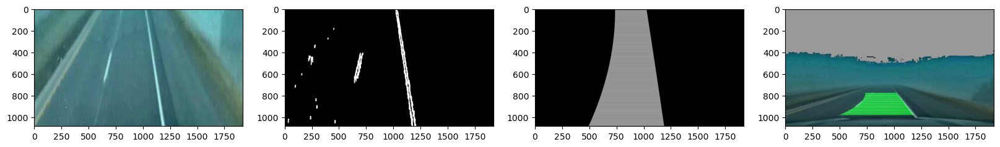

3


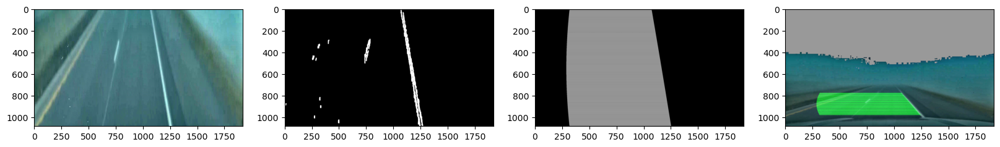

4


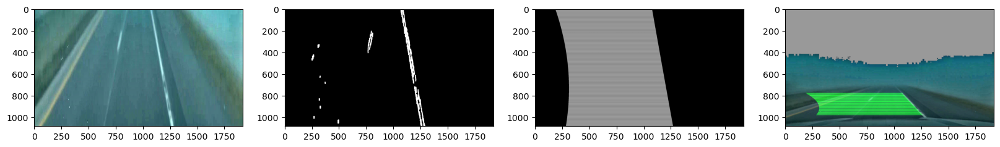

5


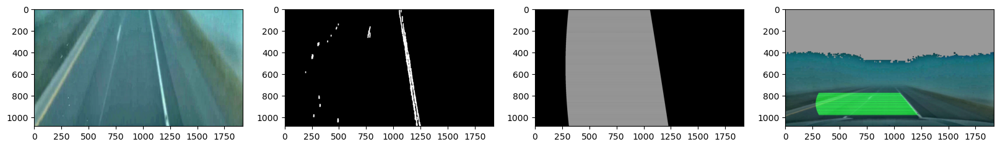

6


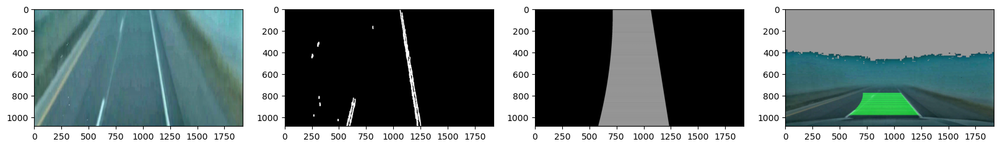

7


KeyboardInterrupt: 

In [3]:
li=[2,3,4,5,6,7,8,48, 54, 58, 155 ,190, 192 ,195 ,205, 221 ,291 ,296, 297]

is_roi=False
kernel =np.ones((3, 3),np.uint8)

left_curve_img = mpimg.imread('left_turn.png')
right_curve_img = mpimg.imread('right_turn.png')
keep_straight_img = mpimg.imread('straight.png')
for i in li:
    print(i)
    img = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
    mask=img.copy()
    mask[:int(2*mask.shape[0]/3)+50,:]=0
    top_view=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)
    top_view = cv2.convertScaleAbs(top_view, alpha=2, beta=25)

    lane_filtered=canny(top_view, 50, 80)
    if is_roi:
        ployy = cv2.dilate(ployy, kernel, iterations=150)
        _, roi = cv2.threshold(ployy, 170, 1, cv2.THRESH_BINARY)
        lane_filtered =lane_filtered * roi
    window_height , nwindows ,nonzero , nonzerox ,nonzeroy = extract_features(lane_filtered , nwindows = 9)
    ployy,is_roi,left_fit,right_fit=fit_poly(lane_filtered)
    if not is_roi:
        lane_filtered=canny(top_view, 50, 80)
        window_height , nwindows ,nonzero , nonzerox ,nonzeroy = extract_features(lane_filtered , nwindows = 9)
        ployy,is_roi,left_fit,right_fit=fit_poly(lane_filtered)
        
    ployy=ployy[:,:,1]-ployy[:,:,0]
    
    back_view=tr_back_view(ployy, img_size=(img.shape[1],img.shape[0]), flags=cv2.INTER_LINEAR)
    out_img = cv2.addWeighted(np.stack((np.zeros_like(back_view),back_view,np.zeros_like(back_view)), axis=-1), 1, cv2.convertScaleAbs(img, alpha=2, beta=25), 0.6, 0)
    
    fig, ax = plt.subplots(1, 4, figsize=(20, 20))
    ax[0].imshow(cv2.cvtColor(top_view, cv2.COLOR_BGR2RGB))
    ax[1].imshow(cv2.cvtColor(lane_filtered, cv2.COLOR_BGR2RGB))
    ax[2].imshow(cv2.cvtColor(ployy, cv2.COLOR_BGR2RGB))
    ax[3].imshow(cv2.cvtColor(out_img, cv2.COLOR_BGR2RGB))
    plt.show()

In [4]:
from tqdm import tqdm
import os
import matplotlib.pyplot as plt
# Define the input and output folder paths
in_folder_path = "1_fog_frames_out"
out_folder_path = "2_lane_frames_out"
i=0
is_roi=False
import matplotlib.image as mpimg
left_curve_img = mpimg.imread('left_turn.png')
right_curve_img = mpimg.imread('right_turn.png')
keep_straight_img = mpimg.imread('straight.png')
kernel =np.ones((3, 3),np.uint8)
def last_4chars(x):
    return(int(x[6:-4]))

for file_name in tqdm(sorted(os.listdir(in_folder_path), key = last_4chars)):

    i+=1
    if file_name.endswith(f"{i}.png"):
        # Construct the full file path
        file_path = os.path.join(in_folder_path, file_name)
        
        img = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
        mask=img.copy()
        mask[:int(2*mask.shape[0]/3)+50,:]=0
        top_view=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)
        top_view = cv2.convertScaleAbs(top_view, alpha=2, beta=25)

        lane_filtered=canny(top_view, 50, 80)
        if is_roi:
            ployy = cv2.dilate(ployy, kernel, iterations=150)
            _, roi = cv2.threshold(ployy, 170, 1, cv2.THRESH_BINARY)
            lane_filtered =lane_filtered * roi
        window_height , nwindows ,nonzero , nonzerox ,nonzeroy = extract_features(lane_filtered , nwindows = 9)
        ployy,is_roi,left_fit,right_fit=fit_poly(lane_filtered)
        ployy=ployy[:,:,1]-ployy[:,:,0]

        back_view=tr_back_view(ployy, img_size=(img.shape[1],img.shape[0]), flags=cv2.INTER_LINEAR)
        out_img = cv2.addWeighted(np.stack((np.zeros_like(back_view),back_view,np.zeros_like(back_view)), axis=-1), 1, cv2.convertScaleAbs(img, alpha=2, beta=25), 0.6, 0)
    
        output_path = os.path.join(out_folder_path, file_name)
        cv2.imwrite(output_path, out_img)
        

100%|████████████████████████████████████████████████████████████████████████████████| 451/451 [02:11<00:00,  3.43it/s]


In [5]:
import os



def last_4chars(x):
    return(int(x[6:-4]))

# Path to the directory containing the frames
frames_folder = "2_lane_frames_out"

# Path to the output video file
output_video = "2_video_lane2.mp4"

# Get the list of frame files in the frames folder
frame_files = sorted(os.listdir('1_fog_frames_out'), key = last_4chars)

# Read the first frame to get the size
first_frame = cv2.imread(os.path.join(frames_folder, frame_files[0]))
frame_height, frame_width, _ = first_frame.shape

# Create a VideoWriter object to write the frames to a video
fourcc = cv2.VideoWriter_fourcc(*"mp4v")  # Specify the codec (MP4V)
fps = 3  # Specify the frames per second
video_writer = cv2.VideoWriter(output_video, fourcc, fps, (frame_width, frame_height))

# Write each frame to the video
for frame_file in frame_files:
    frame_path = os.path.join(frames_folder, frame_file)
    frame = cv2.imread(frame_path)
    video_writer.write(frame)

# Release the video writer
video_writer.release()


# contrast

In [37]:
def run(top_view,image,n_class):
    sigma_est = np.mean(estimate_sigma(top_view, multichannel=True))
    denoise_img = denoise_nl_means(top_view, h=1.15 * sigma_est, fast_mode=True, 
                       patch_size=5, patch_distance=3, multichannel=True)


    image = (exposure.equalize_adapthist(denoise_img))

    thresholds = threshold_multiotsu(image, classes=n_class)


    
    regions = np.digitize(image, bins=thresholds)
    
    regions = random_walker(image, regions+1, beta=10, mode='bf')
    output =(255*(regions/(n_class))).astype(np.uint8)  #Convert 64 bit integer values to uint8

    gray = cv2.cvtColor(output, cv2.COLOR_BGR2GRAY)
    _, output = cv2.threshold(gray, 170, 255, cv2.THRESH_BINARY)
    kernel = np.ones((3, 3), np.uint8)
    
    output = cv2.erode(output, kernel, iterations=2)
    
    return output,image

2


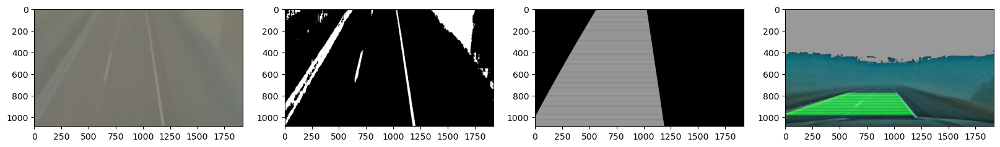

3


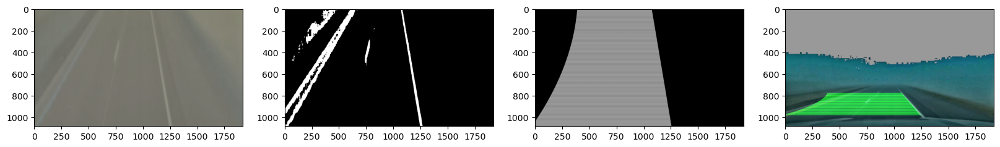

4


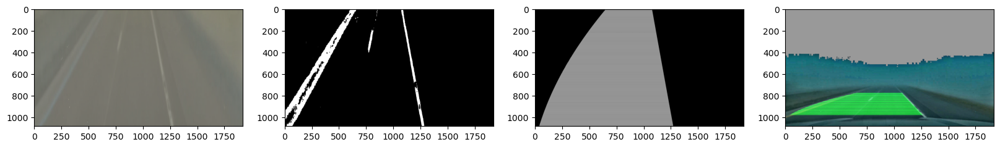

5


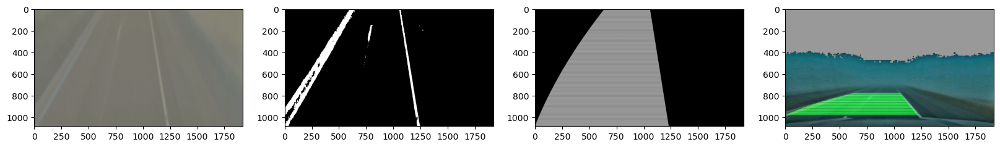

6


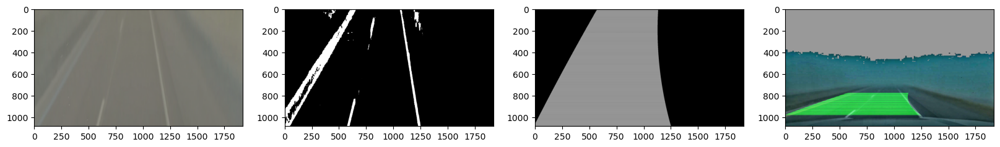

7


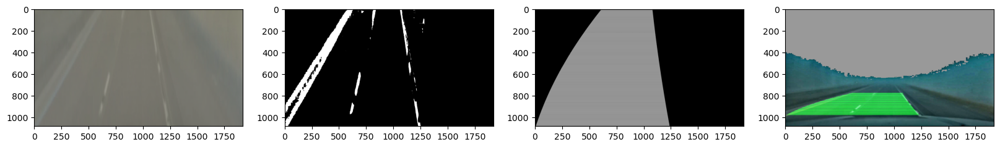

8


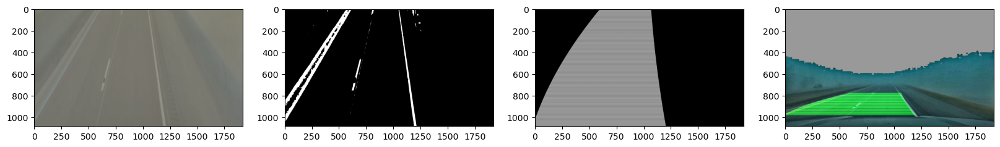

48


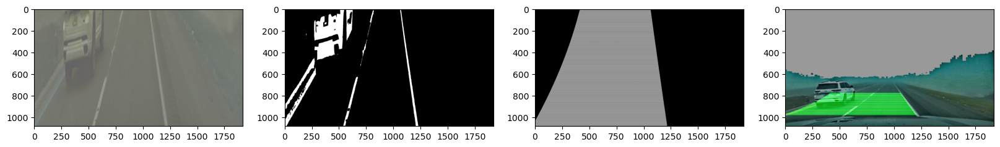

54


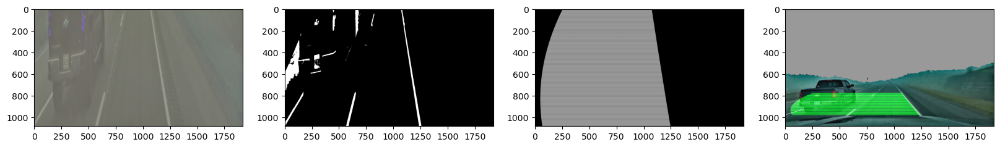

58


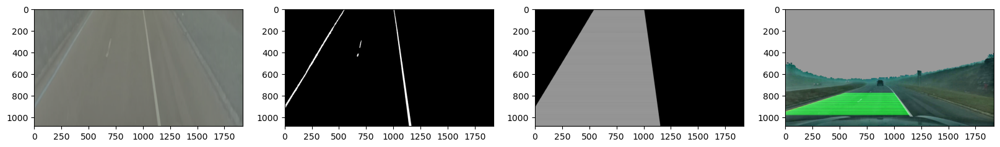

155


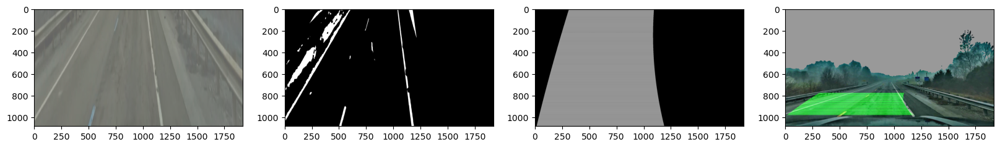

190


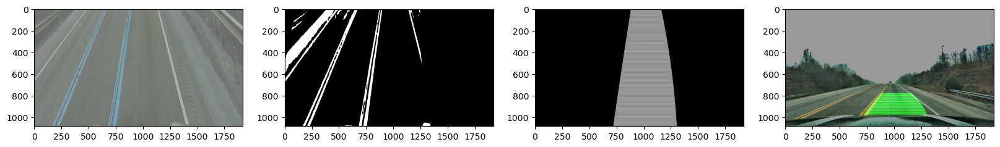

192


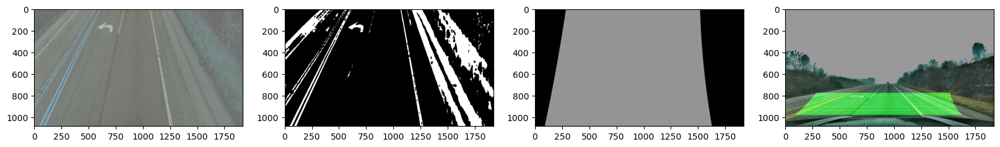

195


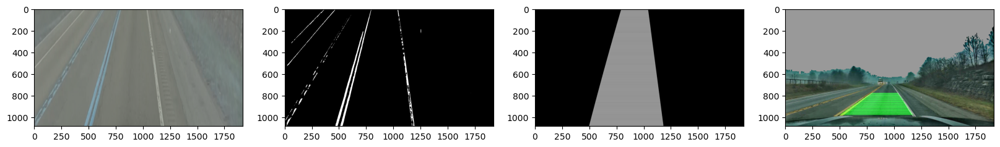

205


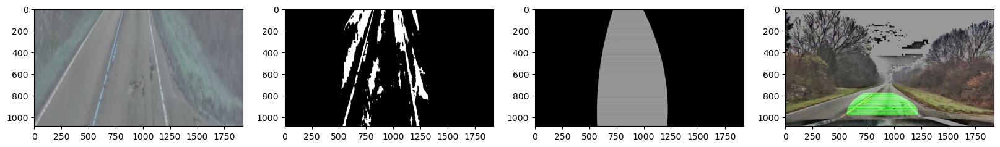

221


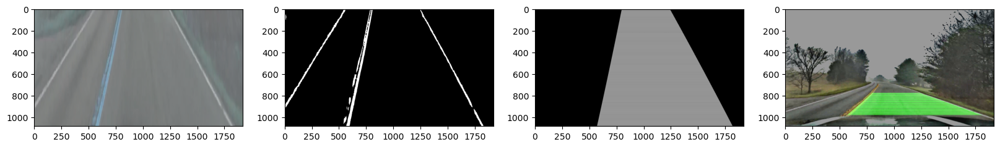

291


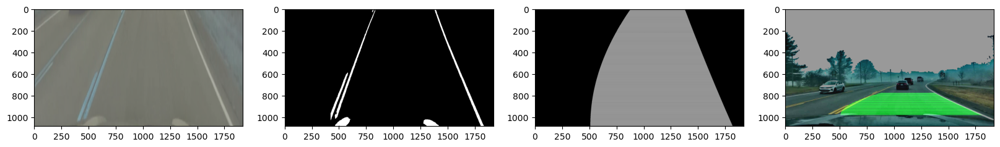

296


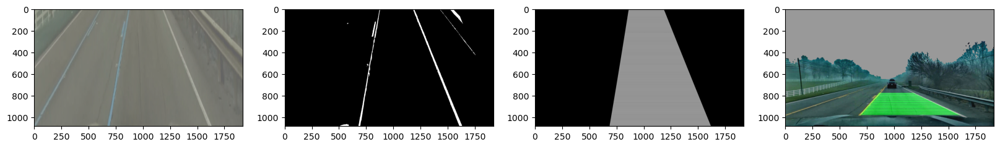

297


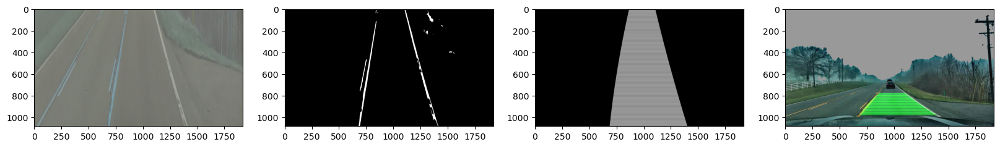

In [39]:
li=[2,3,4,5,6,7,8,48, 54, 58, 155 ,190, 192 ,195 ,205, 221 ,291 ,296, 297]

is_roi=False
kernel =np.ones((3, 3),np.uint8)
n_class=3
left_curve_img = mpimg.imread('left_turn.png')
right_curve_img = mpimg.imread('right_turn.png')
keep_straight_img = mpimg.imread('straight.png')
for i in li:
    print(i)
    image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = image.astype(np.float64) / 255.0
    
    mask=image.copy()
    mask[:int(2*mask.shape[0]/3),:]=0
    mask[1000:,:]=0
    top_view=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)   
    top_view = cv2.convertScaleAbs(top_view, alpha=100, beta=100)

    lane_filtered,image=run(top_view,image,n_class)
    if is_roi:
        ployy = cv2.dilate(ployy, kernel, iterations=150)
        _, roi = cv2.threshold(ployy, 170, 1, cv2.THRESH_BINARY)
        lane_filtered =lane_filtered * roi
    window_height , nwindows ,nonzero , nonzerox ,nonzeroy = extract_features(lane_filtered , nwindows = 9)
    ployy,is_roi,left_fit,right_fit=fit_poly(lane_filtered)
    if not is_roi:
        lane_filtered,image=run(top_view,image,n_class)
        window_height , nwindows ,nonzero , nonzerox ,nonzeroy = extract_features(lane_filtered , nwindows = 9)
        ployy,is_roi,left_fit,right_fit=fit_poly(lane_filtered)
        
    ployy=ployy[:,:,1]-ployy[:,:,0]
    
    back_view=tr_back_view(ployy, img_size=(img.shape[1],img.shape[0]), flags=cv2.INTER_LINEAR)
    image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
    out_img = cv2.addWeighted(np.stack((np.zeros_like(back_view),back_view,np.zeros_like(back_view)), axis=-1), 1, cv2.convertScaleAbs(image, alpha=2, beta=25), 0.6, 0)
    
    fig, ax = plt.subplots(1, 4, figsize=(20, 20))
    ax[0].imshow(cv2.cvtColor(top_view, cv2.COLOR_BGR2RGB))
    ax[1].imshow(cv2.cvtColor(lane_filtered, cv2.COLOR_BGR2RGB))
    ax[2].imshow(cv2.cvtColor(ployy, cv2.COLOR_BGR2RGB))
    ax[3].imshow(cv2.cvtColor(out_img, cv2.COLOR_BGR2RGB))
    plt.show()

In [40]:
from tqdm import tqdm
import os
import matplotlib.pyplot as plt
# Define the input and output folder paths
in_folder_path = "1_fog_frames_out"
out_folder_path = "2_lane_frames_out"
i=0
is_roi=False
import matplotlib.image as mpimg
left_curve_img = mpimg.imread('left_turn.png')
right_curve_img = mpimg.imread('right_turn.png')
keep_straight_img = mpimg.imread('straight.png')
kernel =np.ones((3, 3),np.uint8)
def last_4chars(x):
    return(int(x[6:-4]))

for file_name in tqdm(sorted(os.listdir(in_folder_path), key = last_4chars)):

    i+=1
    if file_name.endswith(f"{i}.png"):
        # Construct the full file path
        file_path = os.path.join(in_folder_path, file_name)
        
        image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = image.astype(np.float64) / 255.0

        mask=image.copy()
        mask[:int(2*mask.shape[0]/3),:]=0
        mask[1000:,:]=0
        top_view=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)   
        top_view = cv2.convertScaleAbs(top_view, alpha=100, beta=100)

        lane_filtered,image=run(top_view,image,n_class)
        if is_roi:
            ployy = cv2.dilate(ployy, kernel, iterations=150)
            _, roi = cv2.threshold(ployy, 170, 1, cv2.THRESH_BINARY)
            lane_filtered =lane_filtered * roi
        window_height , nwindows ,nonzero , nonzerox ,nonzeroy = extract_features(lane_filtered , nwindows = 9)
        ployy,is_roi,left_fit,right_fit=fit_poly(lane_filtered)
        if not is_roi:
            lane_filtered,image=run(top_view,image,n_class)
            window_height , nwindows ,nonzero , nonzerox ,nonzeroy = extract_features(lane_filtered , nwindows = 9)
            ployy,is_roi,left_fit,right_fit=fit_poly(lane_filtered)

        ployy=ployy[:,:,1]-ployy[:,:,0]

        back_view=tr_back_view(ployy, img_size=(img.shape[1],img.shape[0]), flags=cv2.INTER_LINEAR)
        image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
        out_img = cv2.addWeighted(np.stack((np.zeros_like(back_view),back_view,np.zeros_like(back_view)), axis=-1), 1, cv2.convertScaleAbs(image, alpha=2, beta=25), 0.6, 0)
    
        output_path = os.path.join(out_folder_path, file_name)
        cv2.imwrite(output_path, out_img)
        

100%|████████████████████████████████████████████████████████████████████████████████| 451/451 [29:06<00:00,  3.87s/it]


In [3]:
def tr_top_view(img, img_size, flags=cv2.INTER_LINEAR):

    src = np.float32([(350, int(2*img.shape[0]/3)+55),     # top-left
                       (100, img.shape[0]-100),     # bottom-left
                       (img.shape[1]-100, img.shape[0]-100),    # bottom-right
                       (img.shape[1]-350, int(2*img.shape[0]/3)+55)])    # top-right


    dst = np.float32([(350,0),     # top-left
                       (100, img.shape[0]),     # bottom-left
                       (img.shape[1]-100, img.shape[0]),    # bottom-right
                       (img.shape[1]-350, 0)])

    
    
    M = cv2.getPerspectiveTransform(src, dst)
    
    return cv2.warpPerspective(img, M, img_size, flags=flags)


def filter_road(img):
    # Convert image to HSV color space
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # Define lower and upper threshold values for road segmentation
    lower = np.array([0, 0, 215])
    upper = np.array([255, 255, 255])
    
    # Create a mask based on the threshold values
    mask = cv2.inRange(hsv, lower, upper)
    
    # Apply morphological operations to enhance the mask
    kernel = np.ones((3, 3), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=5)
        #     hsv=cv2.bitwise_and(top_view, top_view, mask=thresholded)
    mask = cv2.erode(mask, kernel, iterations=10)
    mask = cv2.dilate(mask, kernel, iterations=10)
    return mask


1


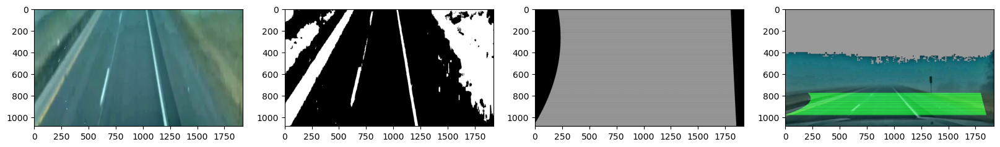

6


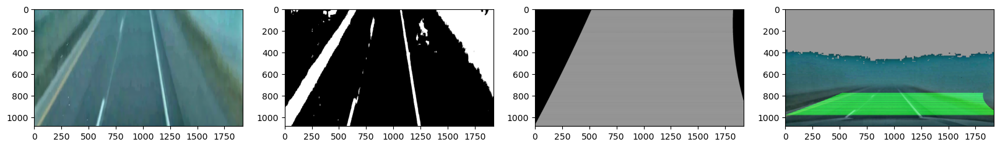

11


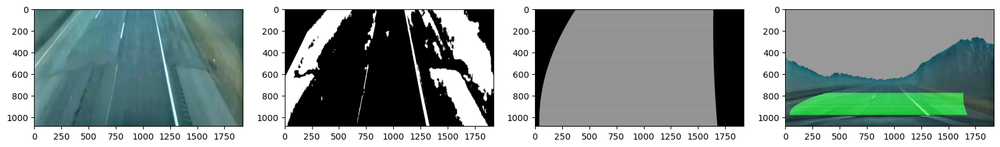

16


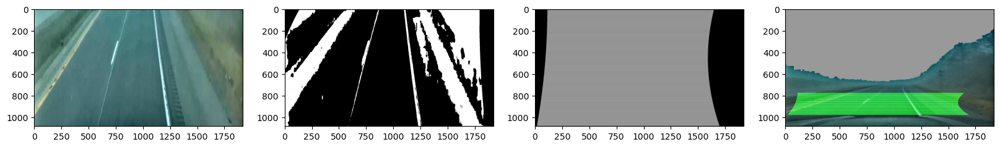

21


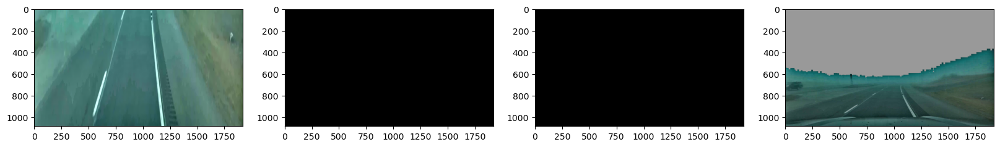

26


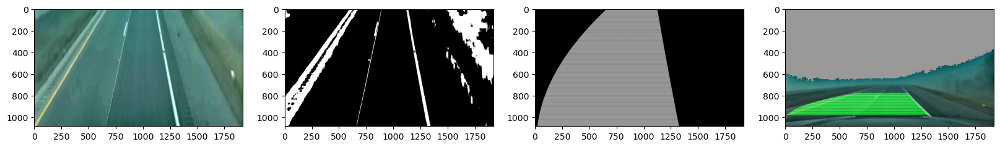

31


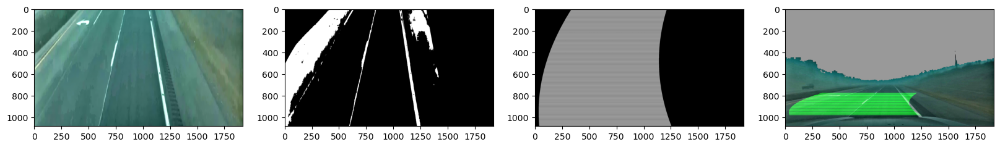

36


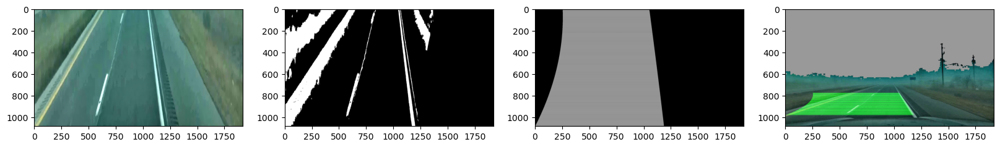

41


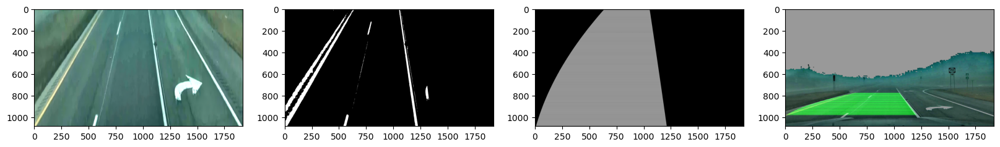

46


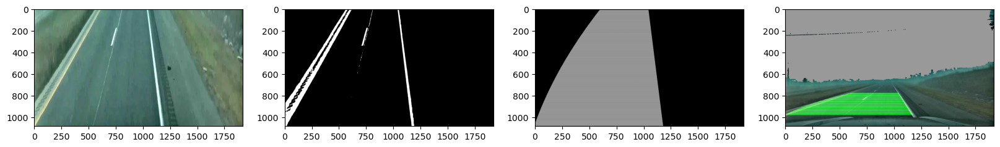

51


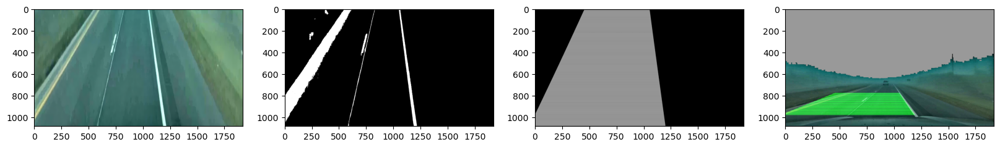

56


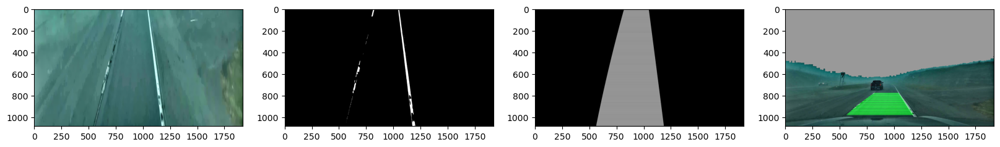

61


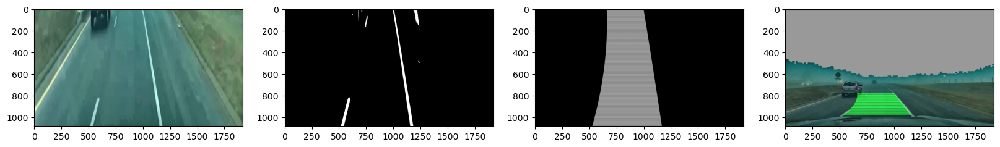

66


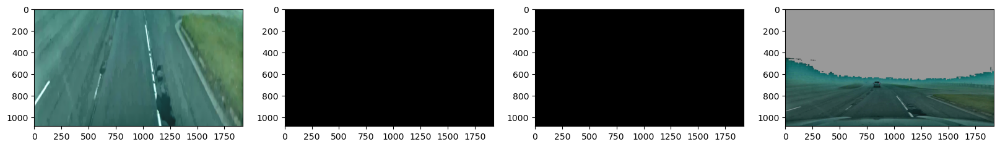

71


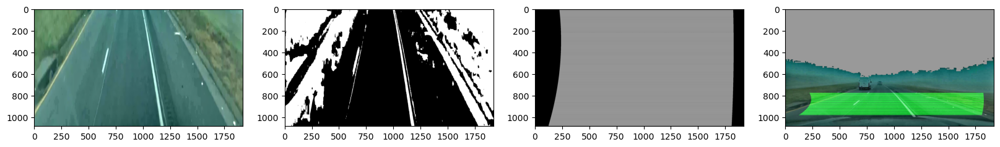

76


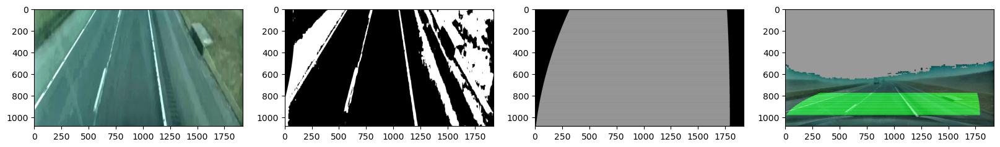

81


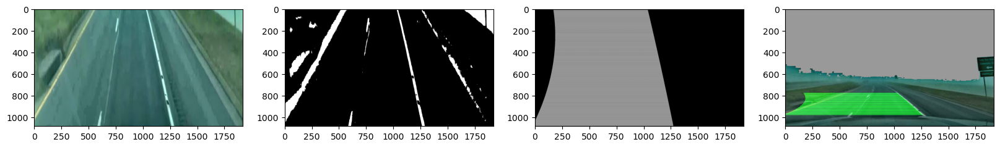

86


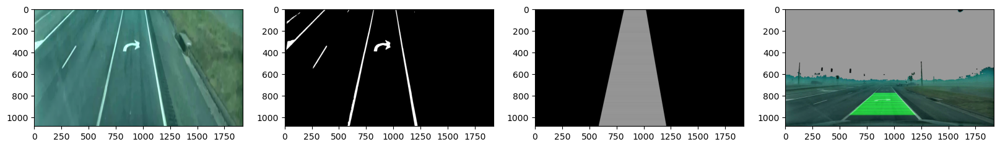

In [13]:
from tqdm import tqdm
import os
import matplotlib.pyplot as plt
# Define the input and output folder paths
in_folder_path = "1_fog_frames_out"
out_folder_path = "2_lane_frames_out"
i=0
is_roi=False
import matplotlib.image as mpimg
left_curve_img = mpimg.imread('left_turn.png')
right_curve_img = mpimg.imread('right_turn.png')
keep_straight_img = mpimg.imread('straight.png')
kernel =np.ones((3, 3),np.uint8)


for i in np.arange(1,89,5):
    print(i)
    image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
        
    mask=image.copy()
    mask[:int(2*mask.shape[0]/3),:]=0
    mask[1000:,:]=0
    mask=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)   
    
#     top_view1 = cv2.convertScaleAbs(mask, alpha=2, beta=20)
#     top_view1=cv2.GaussianBlur(top_view1,(55,55),0)
#     top_view=cv2.cvtColor(top_view1, cv2.COLOR_BGR2HSV)
# #     H,S,V = cv2.split(top_view1)
    
#     fig, ax = plt.subplots(1, 2, figsize=(20, 5))

    
#     ax[0].imshow(cv2.cvtColor(top_view1, cv2.COLOR_BGR2RGB))
#     ax[0].set_title('top_view')
# #     ax[1].axis('off')
#     pixel_vals = top_view.reshape((-1,3))
#     pixel_vals = np.float32(pixel_vals)
#     criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.85)
#     retval, labels, centers = cv2.kmeans(pixel_vals, 4, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
#     centers = np.uint8(centers)
#     segmented_data = centers[labels.flatten()]
#     segmented_image = segmented_data.reshape((image.shape))
#     ax[1].imshow(segmented_image)
#     ax[1].set_title('top_view')
    
#     plt.show()
    
#     top_view1 = cv2.convertScaleAbs(mask, alpha=2, beta=20)
#     top_view1 = cv2.medianBlur(top_view1,45)
#     top_view=cv2.cvtColor(top_view1, cv2.COLOR_BGR2HSV)
# #     H,S,V = cv2.split(top_view1)
    
    
#     fig, ax = plt.subplots(1, 2, figsize=(20, 5))
# # GaussianBlur(img,(5,5),0)
    
#     ax[0].imshow(cv2.cvtColor(top_view1, cv2.COLOR_BGR2RGB))
#     ax[0].set_title('top_view')
# #     ax[1].axis('off')
#     pixel_vals = top_view.reshape((-1,3))
#     pixel_vals = np.float32(pixel_vals)
#     criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.85)
#     retval, labels, centers = cv2.kmeans(pixel_vals, 5, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
#     centers = np.uint8(centers)
#     segmented_data = centers[labels.flatten()]
#     segmented_image = segmented_data.reshape((image.shape))
#     ax[1].imshow(segmented_image)
#     ax[1].set_title('top_view')
#     plt.show()
    
    
        
    top_view1 = cv2.convertScaleAbs(mask, alpha=2, beta=20)
    top_view1 = cv2.bilateralFilter(top_view1,45,10,10)
    top_view=cv2.cvtColor(top_view1, cv2.COLOR_BGR2HSV)
    H,S,V = cv2.split(top_view1)
    
    
#     fig, ax = plt.subplots(1, 3, figsize=(20, 5))
# # GaussianBlur(img,(5,5),0)
    
#     ax[0].imshow(cv2.cvtColor(top_view1, cv2.COLOR_BGR2RGB))
#     ax[0].set_title('top_view')
#     ax[1].axis('off')
    pixel_vals = V.reshape((-1,1))
    pixel_vals = np.float32(pixel_vals)
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.85)
    retval, labels, centers = cv2.kmeans(pixel_vals, 2, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    centers = np.uint8(centers)
    segmented_data = centers[labels.flatten()]
    segmented_image = segmented_data.reshape((V.shape))
    ret, lane_filtered = cv2.threshold(segmented_image, 100, 255, cv2.THRESH_BINARY)

    
    
    if is_roi:
        ployy = cv2.dilate(ployy, kernel, iterations=150)
        _, roi = cv2.threshold(ployy, 170, 1, cv2.THRESH_BINARY)
        lane_filtered =lane_filtered * roi
        
    window_height , nwindows ,nonzero , nonzerox ,nonzeroy = extract_features(lane_filtered , nwindows = 9)
    ployy,is_roi,left_fit,right_fit=fit_poly(lane_filtered)
    
    if not is_roi:
        ret, lane_filtered = cv2.threshold(segmented_image, 100, 255, cv2.THRESH_BINARY)
        window_height , nwindows ,nonzero , nonzerox ,nonzeroy = extract_features(lane_filtered , nwindows = 9)
        ployy,is_roi,left_fit,right_fit=fit_poly(lane_filtered)
        
    ployy=ployy[:,:,1]-ployy[:,:,0]
    back_view=tr_back_view(ployy, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)
    image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
    out_img = cv2.addWeighted(np.stack((np.zeros_like(back_view),back_view,np.zeros_like(back_view)), axis=-1), 1, cv2.convertScaleAbs(image, alpha=2, beta=25), 0.6, 0)
    
    fig, ax = plt.subplots(1, 4, figsize=(20, 20))
    ax[0].imshow(cv2.cvtColor(top_view1, cv2.COLOR_BGR2RGB))
    ax[1].imshow(cv2.cvtColor(lane_filtered, cv2.COLOR_BGR2RGB))
    ax[2].imshow(cv2.cvtColor(ployy, cv2.COLOR_BGR2RGB))
    ax[3].imshow(cv2.cvtColor(out_img, cv2.COLOR_BGR2RGB))
    plt.show()
#     resized_image = cv2.resize(segmented_image, (0,0), fx=0.1, fy=0.1)
#     seed = (40,100)
#     ret, img = cv2.threshold(resized_image, 100, 255, cv2.THRESH_BINARY_INV)
#     out = region_growing(img, seed)
#     ax[2].imshow(out)
#     plt.show()
    
#     break


In [5]:
segmented_image

array([[105, 105, 105, ...,  64,  64,  64],
       [105, 105, 105, ...,  64,  64,  64],
       [105, 105, 105, ...,  64,  64,  64],
       ...,
       [105, 105, 105, ...,  64,  64,  64],
       [105, 105, 105, ...,  64,  64,  64],
       [105, 105, 105, ...,  64,  64,  64]], dtype=uint8)

In [4]:

# for i in np.arange(1,89,5):
#     print(i)
#     image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
#     image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#     mask=image.copy()
#     mask[:int(2*mask.shape[0]/3),:]=0
#     mask[1000:,:]=0
#     top_view=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)   
    
    
#     fig, ax = plt.subplots(1, 2, figsize=(20, 3))
#     ax[0].imshow(image)
#     ax[0].set_title('top_view')
# #     ax[0].axis('off')
    
#     ax[1].imshow(top_view)
#     ax[1].set_title('top_view')
# #     ax[1].axis('off')
    
    
#     plt.show()

In [9]:
import cv2
import numpy as np

def get8n(x, y, shape):
    out = []
    maxx = shape[1]-1
    maxy = shape[0]-1
    
    #top left
    outx = min(max(x-1,0),maxx)
    outy = min(max(y-1,0),maxy)
    out.append((outx,outy))
    
    #top center
    outx = x
    outy = min(max(y-1,0),maxy)
    out.append((outx,outy))
    
    #top right
    outx = min(max(x+1,0),maxx)
    outy = min(max(y-1,0),maxy)
    out.append((outx,outy))
    
    #left
    outx = min(max(x-1,0),maxx)
    outy = y
    out.append((outx,outy))
    
    #right
    outx = min(max(x+1,0),maxx)
    outy = y
    out.append((outx,outy))
    
    #bottom left
    outx = min(max(x-1,0),maxx)
    outy = min(max(y+1,0),maxy)
    out.append((outx,outy))
    
    #bottom center
    outx = x
    outy = min(max(y+1,0),maxy)
    out.append((outx,outy))
    
    #bottom right
    outx = min(max(x+1,0),maxx)
    outy = min(max(y+1,0),maxy)
    out.append((outx,outy))
    
    return out

def region_growing(img, seed):
    seed_points = []
    outimg = np.zeros_like(img)
    seed_points.append((seed[0], seed[1]))
    processed = []
    while(len(seed_points) > 0):
        pix = seed_points[0]
        outimg[pix[0], pix[1]] = 255
        
        for coord in get8n(pix[0], pix[1], img.shape):
            try:
                if img[coord[0], coord[1]] != 0:
                    outimg[coord[0], coord[1]] = 255
                    if not coord in processed:
                        seed_points.append(coord)
                    processed.append(coord)
            except:
                pass
        seed_points.pop(0)

    return outimg






image=resized_image.copy()
ret, img = cv2.threshold(image, 100, 255, cv2.THRESH_BINARY_INV)
img[:5,:]=0
img[-5:,:]=0
seed = (40,100)
out = region_growing(img, seed)
cv2.imshow('Inpukt', out)
cv2.waitKey(0)
cv2.destroyAllWindows() 


NameError: name 'resized_image' is not defined

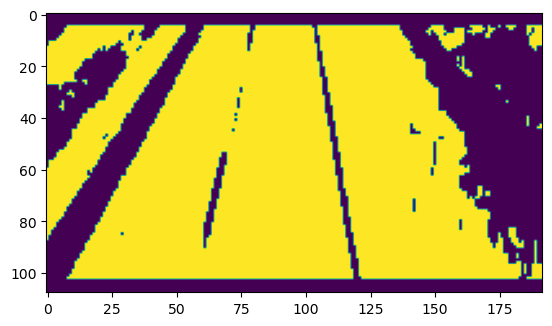

In [23]:

plt.imshow(img)

In [ ]:
import cv2
import numpy as np

def get_neighbouring_pixels(x, y, shape):
    neighbours = []
    max_x = shape[1] - 1
    max_y = shape[0] - 1
    directions = [(-1, -1), (0, -1), (1, -1), (-1, 0), (1, 0), (-1, 1), (0, 1), (1, 1)]

    for dx, dy in directions:
        nx, ny = x + dx, y + dy
        if 0 <= nx <= max_x and 0 <= ny <= max_y:
            neighbours.append((nx, ny))

    return neighbours

def color_distance(color1, color2):
    return np.sqrt(np.sum((color1 - color2) ** 2))

def region_growing(img, seed, threshold):
    seed_points = [seed]
    out_img = np.zeros_like(img)
    processed = []

    while seed_points:
        pix = seed_points.pop(0)
        out_img[pix] = img[pix]

        for coord in get_neighbouring_pixels(*pix, img.shape):
            if color_distance(img[seed], img[coord]) < threshold and coord not in processed:
                out_img[coord] = img[coord]
                seed_points.append(coord)
                processed.append(coord)

    return out_img

image = cv2.imread('image.jpg')  # replace with your image path
seed = (40, 100)
color_threshold = 30.0  # adjust this value based on your requirements
out = region_growing(image, seed, color_threshold)

cv2.imshow('Output', out)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:

import cv2
import numpy as np




def search_new_seed(classified_pixels, seed_x,seed_y,img, region_mean,threshold):
    img_h, img_w = img.shape
    for i in range(seed_x, img_w):
        for k in range(seed_y, img_h):
            if [i,k] in classified_pixels:
                continue
            if img[i][k] <= region_mean + threshold: #pick new seed
           #     print("found", i,k)
                classified_pixels.append([i,k])
                return [i,k]
 #   print("no neww seed")       
    return [-1,-1]        

def region_growing(img, seed, threshold, connectivity):
    img_height, img_width = img.shape
    segmented_image = img.copy()    
    
    segmented_image = np.zeros((img_width,img_height), dtype=img.dtype)
    segmented_image = [[element + 255 for element in sub_im] for sub_im in segmented_image]
    
  #  print(segmented_image)
    
    seed_quantity = len(seed)
    flags = [1] * seed_quantity # these flags will hold the info about "whether the seed continue growing or it stopped"
    region_means = [0] * seed_quantity # region mean for each region (different region for each seed) 
    region_sizes = [1] * seed_quantity # region size for each region (different region for each seed)  
    label_list = [0] * seed_quantity # different label for each seed this list will be updated before growing starts
    classified_pixels = [] # we shouldn't visite a neighbor pixel already classified in a region
    visited_pixels_intensities_dif = [] # it wil keep intensity values of each neighbor pixel. After "minimmum" comparison, it well be cleared for the next tour
   
    
    print("seed quantity",seed_quantity)
    print("seeds",seed)    
    print("flags",flags)
    print("im w im h")
    print(img_width, img_height)  
    
    """ check if connectivity parameter is compatible"""
    
    if connectivity == 4:
        neighbor_pixels = [(-1, 0), (1, 0), (0, -1), (0, 1)]
    elif connectivity == 8:
        neighbor_pixels = [(-1, -1),(-1, 0), (-1, 1), (1, -1), (1, 0), (1, 1),(0, -1), (0, 1)]
    else:
        raise ValueError("Invalid connectivity choice! put 4 for 4-connectivity and 8 for 8-connectivity")

    
    """ check if seed parameter is compatible"""
    
    label = 0
    for i in range(seed_quantity):
        if seed[i][0] < img_width  and seed[i][1] < img_height: # if the seed is compatible, initialize the necesseary parts for that seed
            classified_pixels.append(seed[i].copy()) # we should keep the track list about the pixels to see if they are already visited or not
            label_list[i] = label
            segmented_image[seed[i][0]][seed[i][1]] = label #each seed has a unique label so we can keep the different regions via this labels
            label += 20 # change the label for next seed
            region_means[i] = img[seed[i][1]][seed[i][0]]  #initialize region means with only seed intensities, 
            pass
        else:
             raise ValueError("Invalid seed selection, seed coordinates can't be out of image borders")

    
    while len(classified_pixels) < img_height * img_width and 1 in flags:
        for k in range(seed_quantity):
            if flags[k] == 0:
                continue
            for i in range(connectivity):
                tmpx_visited = seed[k][0] + neighbor_pixels[i][0]
                tmpy_visited = seed[k][1] + neighbor_pixels[i][1]
                         
                if [tmpx_visited,tmpy_visited] in classified_pixels:
                    continue
                
                if tmpx_visited < img_width and tmpx_visited >= 0 and tmpy_visited < img_height and tmpy_visited >= 0:
                    x_visited = tmpx_visited
                    y_visited = tmpy_visited
                    classified_pixels.append([seed[k][0] + neighbor_pixels[i][0],seed[k][1] + neighbor_pixels[i][1]])
                    if abs(img[y_visited][x_visited] - region_means[k]) <= threshold:
                        segmented_image[seed[k][1] + neighbor_pixels[i][1]][seed[k][0] + neighbor_pixels[i][0]]  = label_list[k]
                        region_means[k] = (region_sizes[k] * region_means[k] + img[y_visited][x_visited] ) / (region_sizes[k] + 1)
                        region_sizes[k] += 1
                        last_x_accepted = seed[k][0] + neighbor_pixels[i][0]
                        last_y_accepted = seed[k][1] + neighbor_pixels[i][1]
                                            
            if seed[k][0] == last_x_accepted and seed[k][1] == last_y_accepted:
                    new_seed = search_new_seed(classified_pixels,last_x_accepted, last_y_accepted,img, region_means[k],threshold)
                    if new_seed == [-1,-1]:
                        flags[k] = 0 #that seed cant grow anymore
                    else:
                        seed[k][0] = new_seed[0]
                        seed[k][1] = new_seed[1]
            else:            
                seed[k][0] = last_x_accepted
                seed[k][1] = last_y_accepted
        
          
  #       print(segmented_image)
  #       print("last seed was:", seed[k][0], seed[k][1])   
    return segmented_image
        

    

img2 = cv2.imread("1_fog_frames_out/frame_1.png", 0)   
# img2 = cv2.resize(img2, (125,125))


output = region_growing(img2, [[800,1000]] ,10, 8)
cv2.imshow("Segmented  Image", np.array(output, dtype=img2.dtype))
cv2.waitKey(0)
cv2.destroyAllWindows() 


        
        


In [22]:
set(segmented_image.flat)

{64, 105}

1


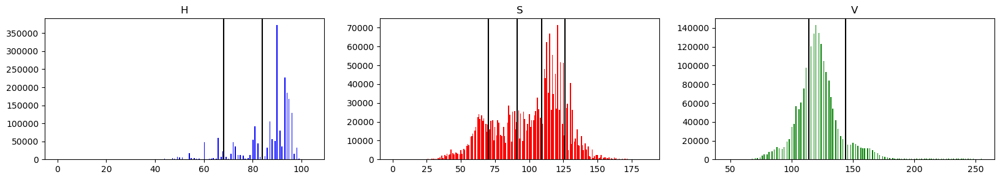

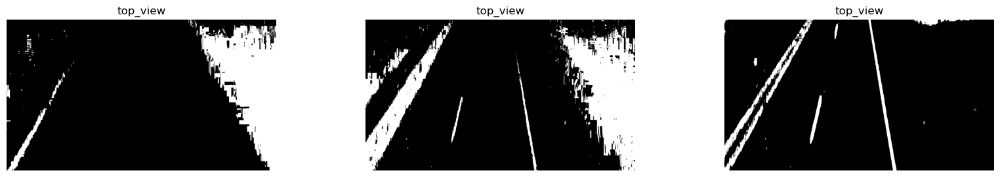

6


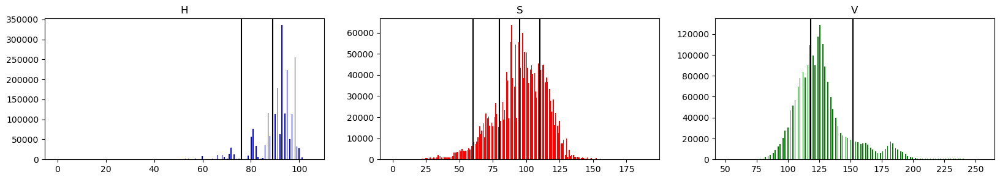

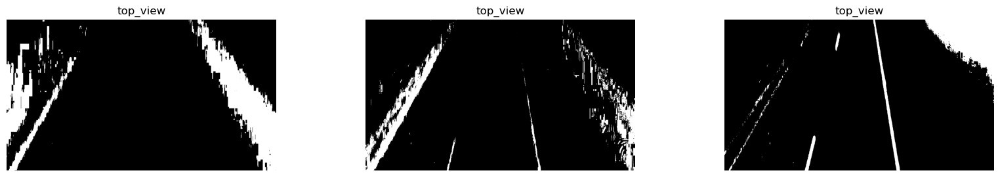

11


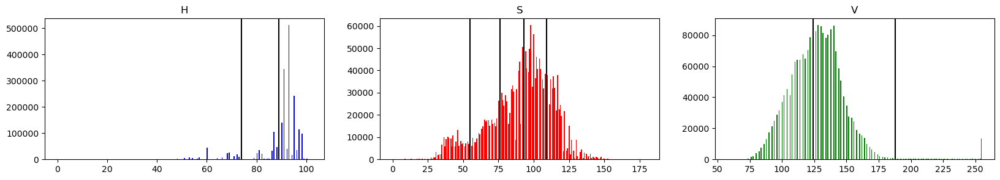

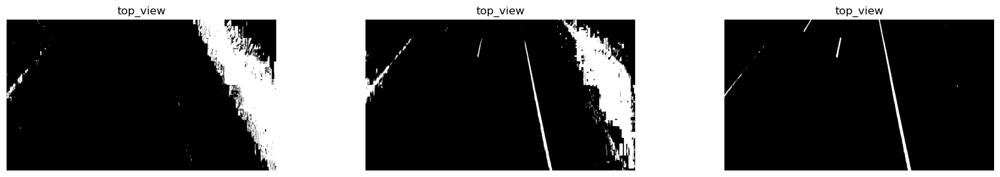

16


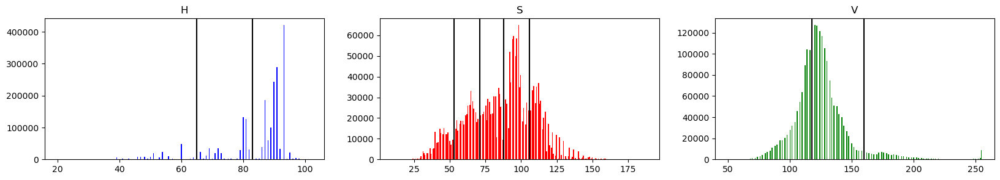

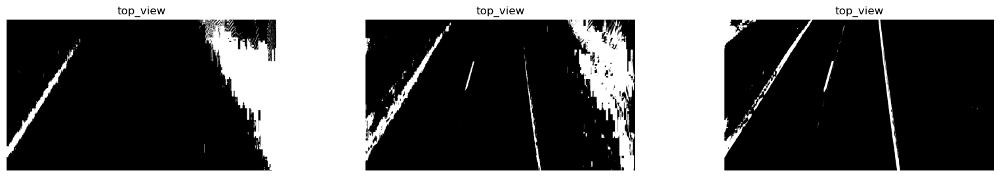

21


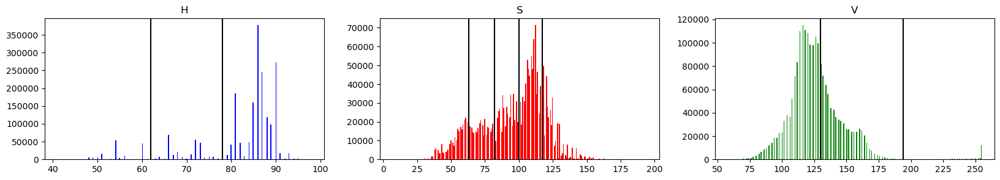

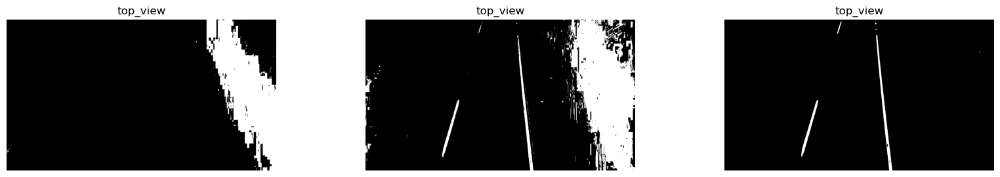

26


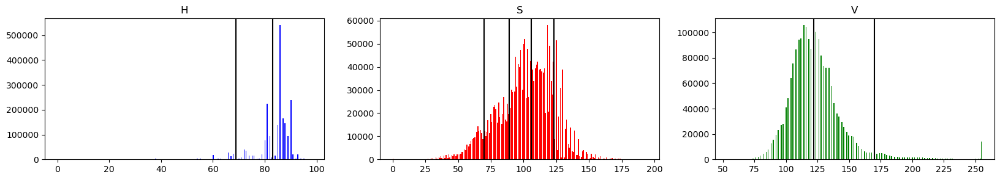

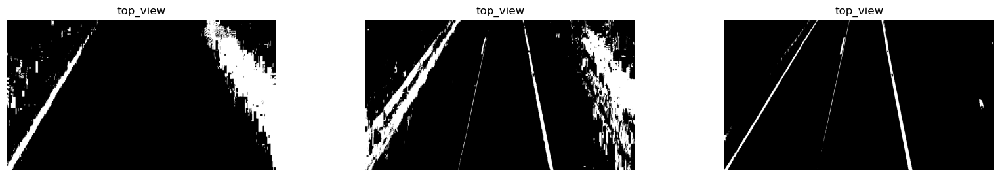

31


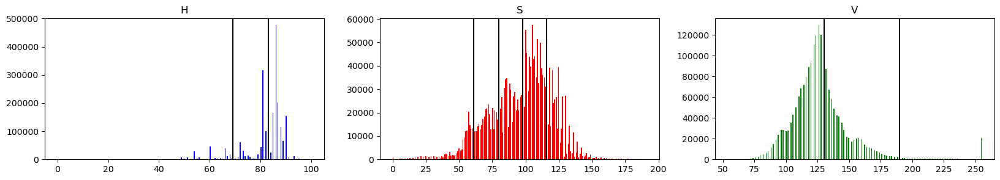

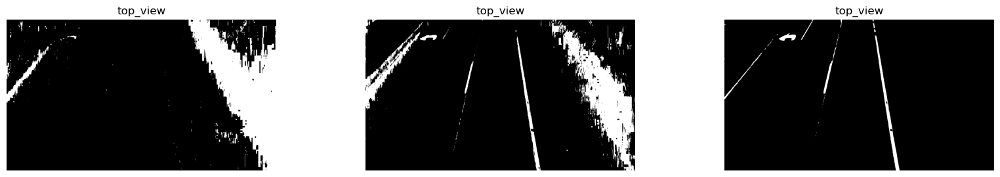

36


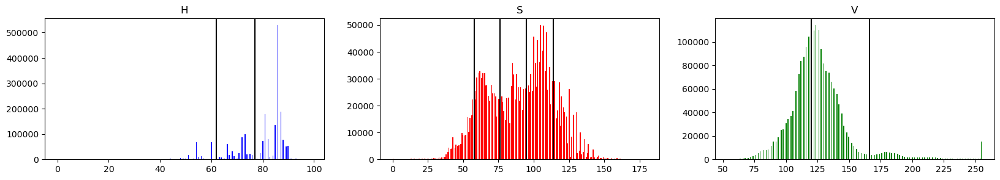

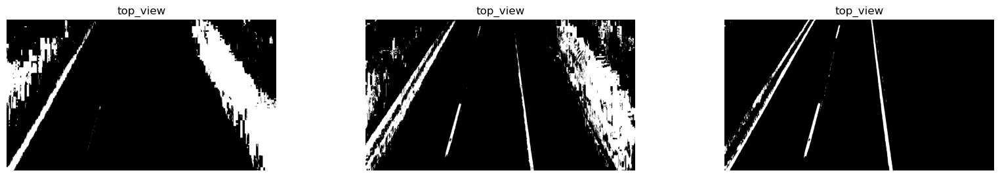

41


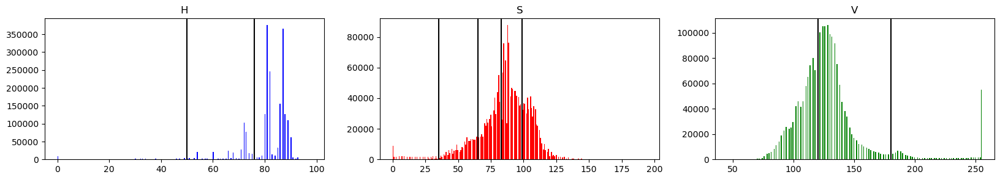

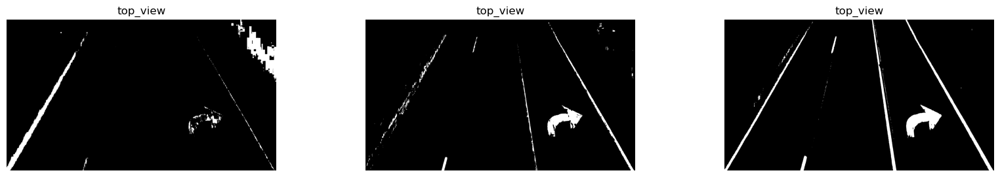

46


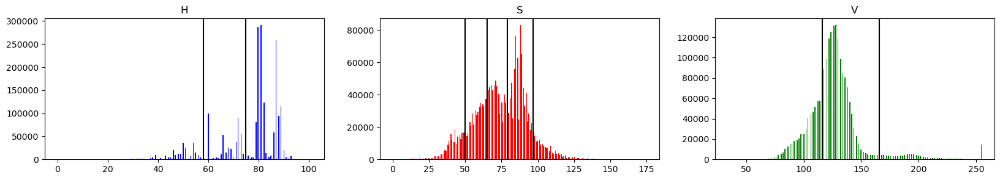

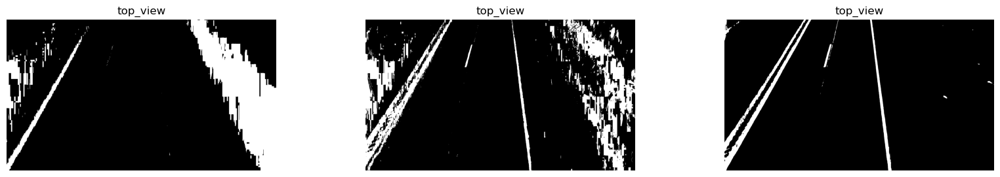

51


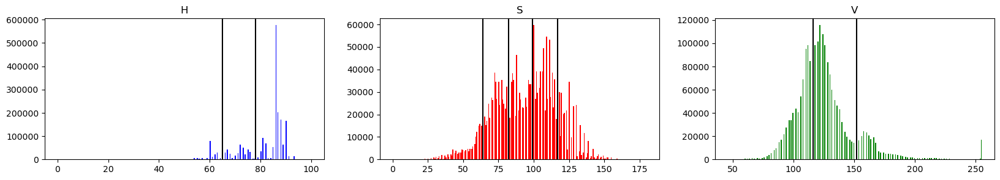

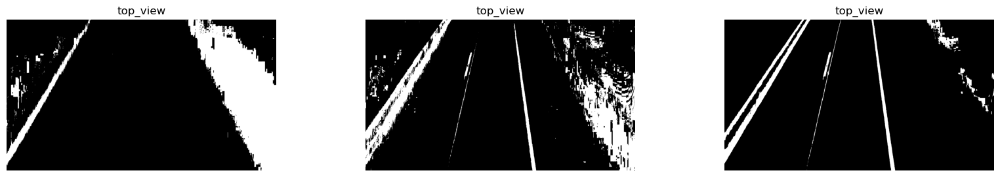

56


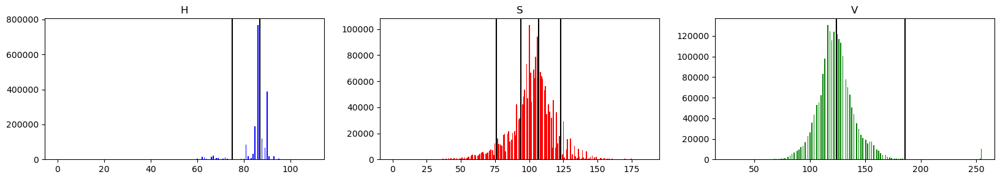

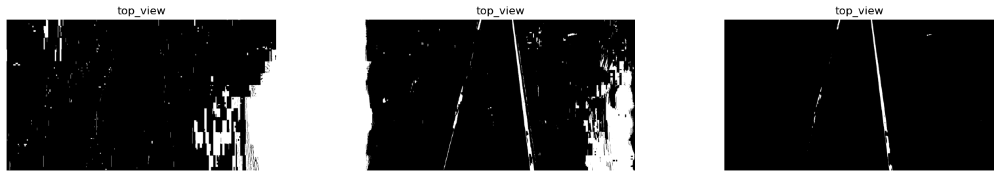

61


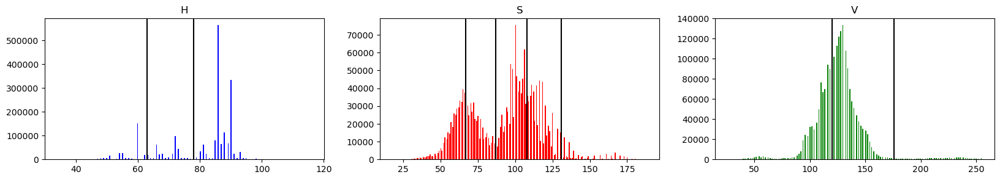

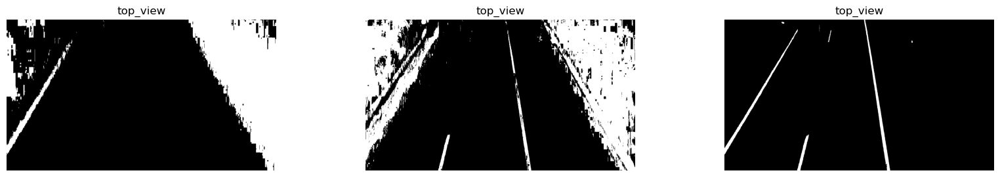

66


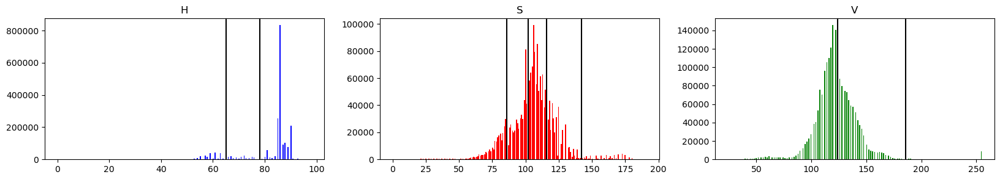

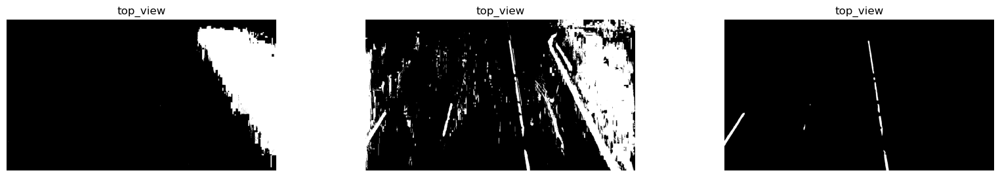

71


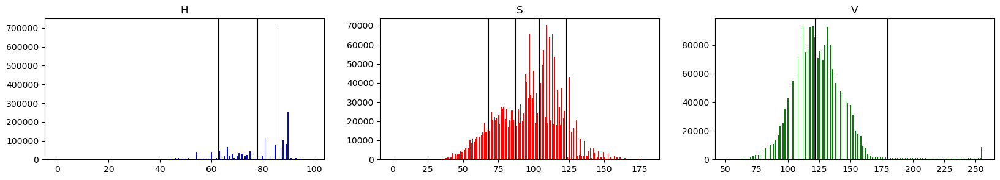

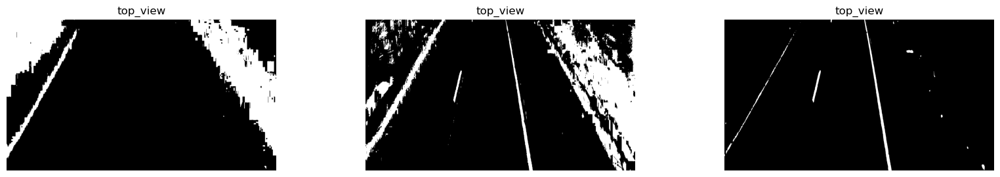

76


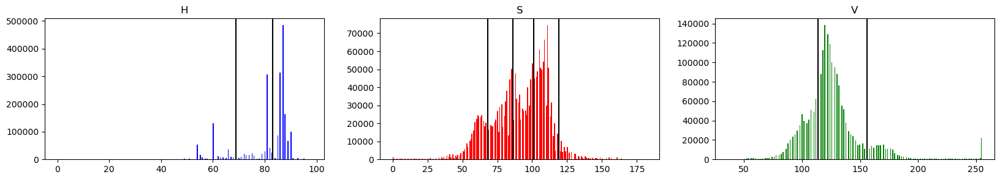

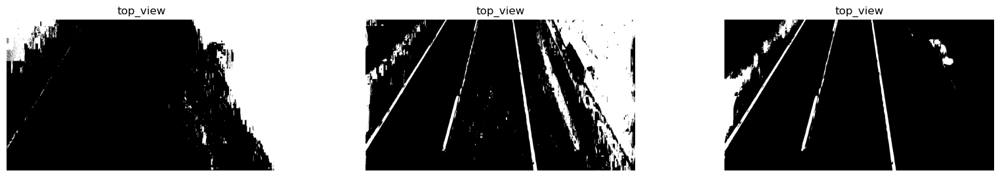

81


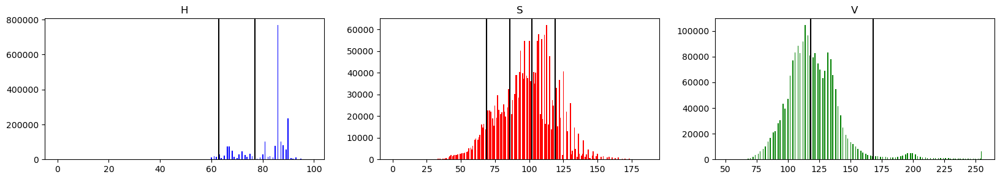

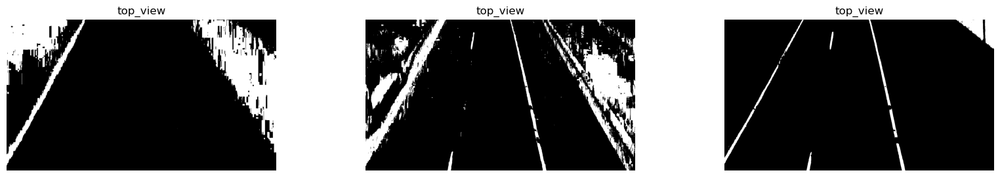

86


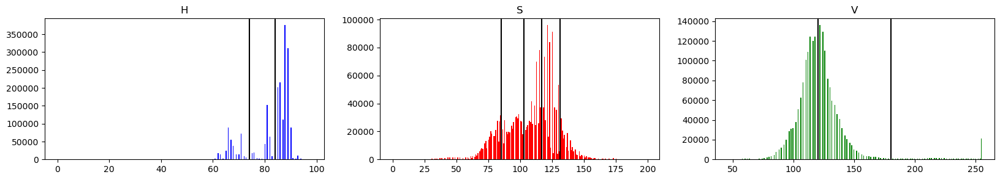

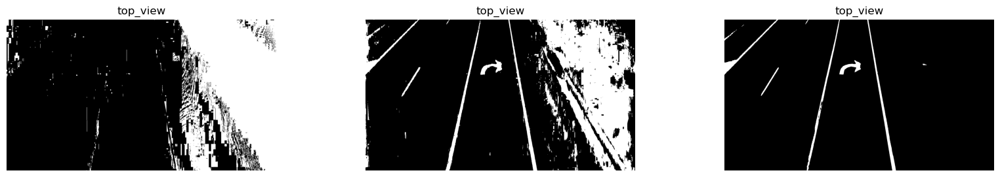

In [29]:
for i in np.arange(1,89,5):
    print(i)
    image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
        
    mask=image.copy()
    mask[:int(2*mask.shape[0]/3),:]=0
    mask[1000:,:]=0
    top_view=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)   
    
    top_view1 = cv2.convertScaleAbs(top_view, alpha=2, beta=20)
#     top_view1 = cv2.bilateralFilter(top_view1,45,10,10)
    top_view1=cv2.cvtColor(top_view1, cv2.COLOR_BGR2HSV)
    H,S,V = cv2.split(top_view1)
    

    
    fig, ax = plt.subplots(1, 3, figsize=(20, 3))
    ax[0].hist(H.ravel(), bins=255,color='blue')
    ax[0].set_title('H')
    Hthresholds = threshold_multiotsu(H, classes=3)
    for thresh in Hthresholds:
        ax[0].axvline(thresh, color='black')
    
    ax[1].hist(S.ravel(), bins=255,color='red')
    ax[1].set_title('S')
    Sthresholds = threshold_multiotsu(S, classes=5)
    for thresh in Sthresholds:
        ax[1].axvline(thresh, color='black')
    
    ax[2].hist(V.ravel(), bins=255,color='green')
    ax[2].set_title('V')
    Vthresholds = threshold_multiotsu(V, classes=3)
    for thresh in Vthresholds:
        ax[2].axvline(thresh, color='black')

    plt.show()     
        
        
    fig, ax = plt.subplots(1, 3, figsize=(20, 3))
    _, output = cv2.threshold(H, 1.1*Hthresholds[0], 255, cv2.THRESH_BINARY_INV)

    ax[0].imshow(output,cmap='gray')
    ax[0].set_title('top_view')
    ax[0].axis('off')
    
    _, output = cv2.threshold(S, 1.1*Sthresholds[0], 255, cv2.THRESH_BINARY_INV)

    ax[1].imshow(output,cmap='gray')
    ax[1].set_title('top_view')
    ax[1].axis('off')
    
    _, output = cv2.threshold(V, 1.1*Vthresholds[-1], 255, cv2.THRESH_BINARY)
    
    ax[2].imshow(output,cmap='gray')
    ax[2].set_title('top_view')
    ax[2].axis('off')
    
    
    plt.show()
    

In [79]:
# for i in np.arange(1,89,5):
#     print(i)
#     image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
        
#     mask=image.copy()
#     mask[:int(2*mask.shape[0]/3),:]=0
#     mask[1000:,:]=0
#     top_view=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)   
    
#     top_view1 = cv2.convertScaleAbs(top_view, alpha=2, beta=20)
#     top_view1=cv2.cvtColor(top_view1, cv2.COLOR_BGR2YCrCb)
#     Y,Cr,Cb = cv2.split(top_view1)
    

    
#     fig, ax = plt.subplots(1, 3, figsize=(20, 3))
#     ax[0].hist(Y.ravel(), bins=255,color='blue')
#     ax[0].set_title('Y')
#     Ythresholds = threshold_multiotsu(Y, classes=3)
#     for thresh in Ythresholds:
#         ax[0].axvline(thresh, color='black')
    
#     ax[1].hist(Cr.ravel(), bins=255,color='red')
#     ax[1].set_title('Cr')
#     Crthresholds = threshold_multiotsu(Cr, classes=5)
#     for thresh in Crthresholds:
#         ax[1].axvline(thresh, color='black')
    
#     ax[2].hist(Cb.ravel(), bins=255,color='green')
#     ax[2].set_title('Cb')
#     Cbthresholds = threshold_multiotsu(Cb, classes=3)
#     for thresh in Cbthresholds:
#         ax[2].axvline(thresh, color='black')

#     plt.show()     
        
        
#     fig, ax = plt.subplots(1, 3, figsize=(20, 3))
#     ax[0].imshow(Y,cmap='gray')
#     ax[0].set_title('top_view')
#     ax[0].axis('off')

#     _, output = cv2.threshold(Cr, Crthresholds[-1], 255, cv2.THRESH_BINARY)
    
#     ax[1].imshow(output,cmap='gray')
#     ax[1].set_title('top_view')
#     ax[1].axis('off')
    
    
#     ax[2].imshow(Cb,cmap='gray')
#     ax[2].set_title('top_view')
#     ax[2].axis('off')
    
    
#     plt.show()
    

1


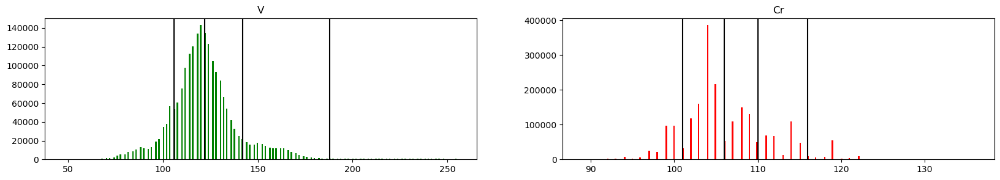

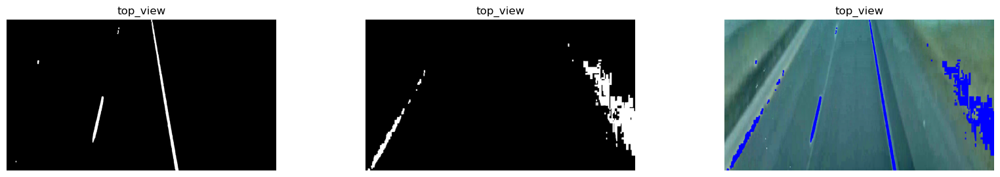

6


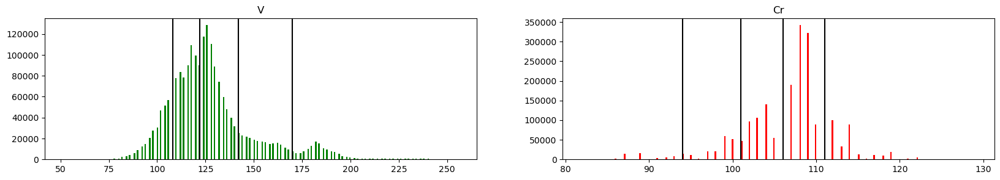

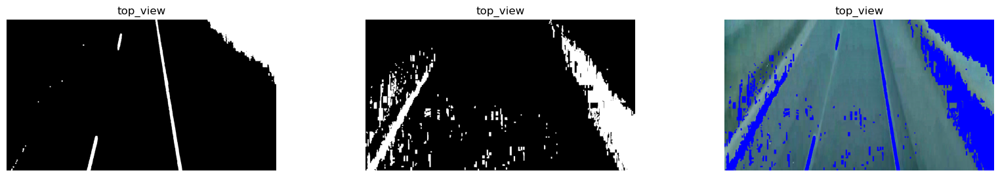

11


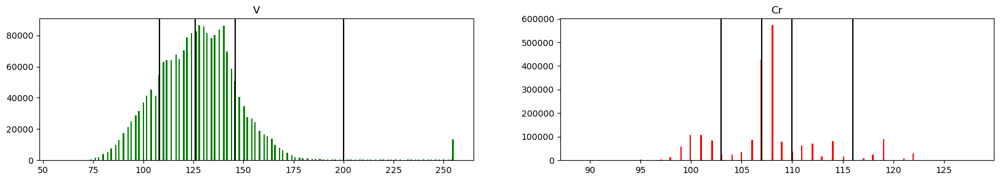

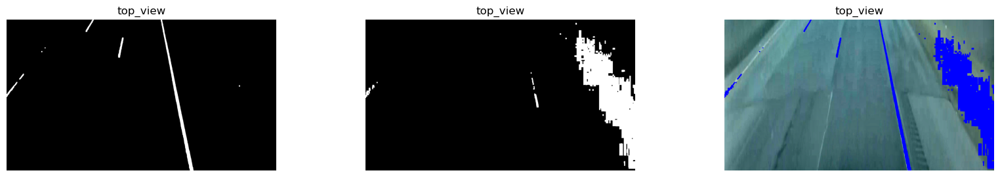

16


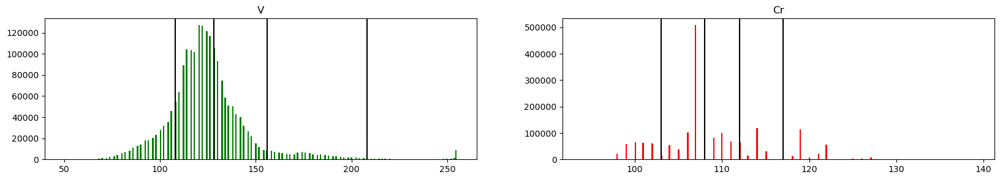

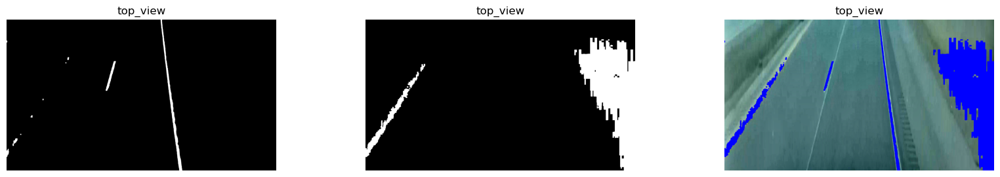

21


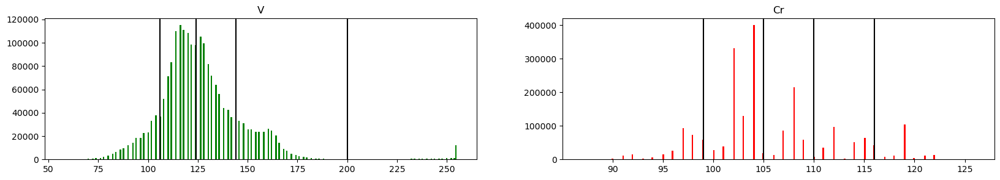

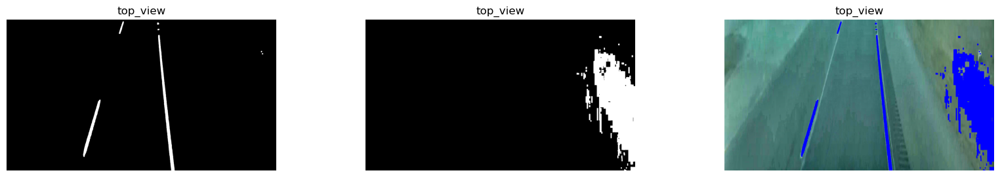

26


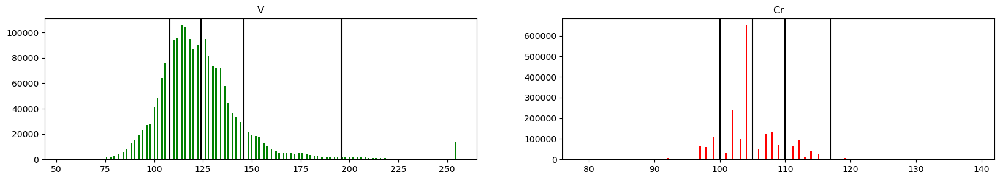

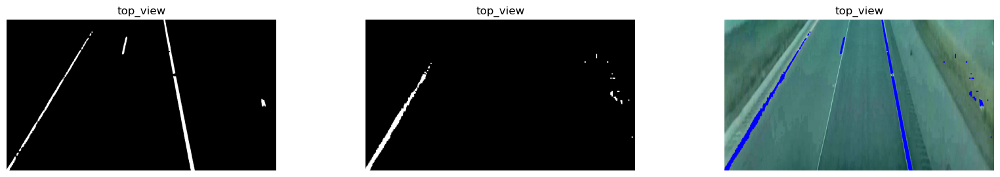

31


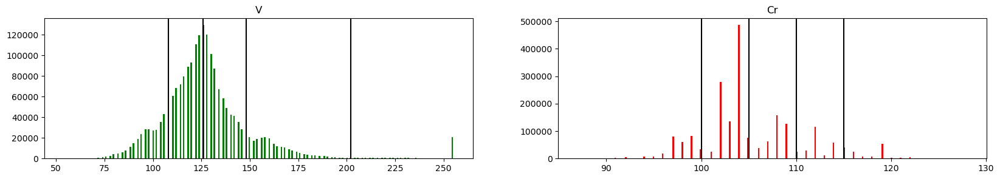

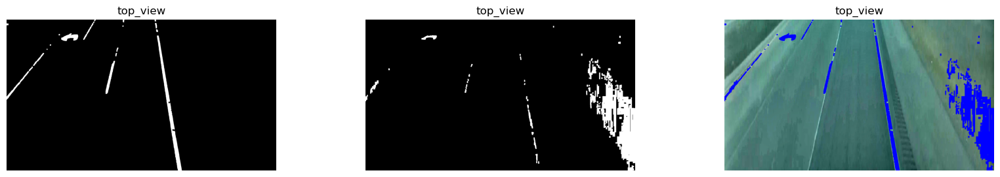

36


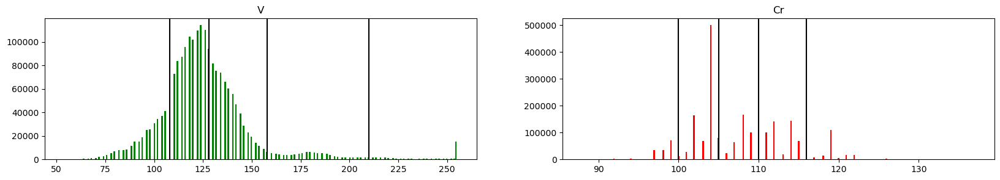

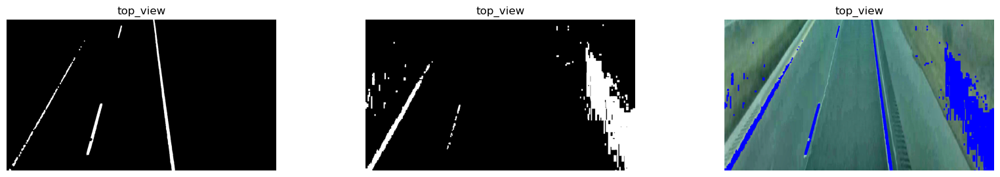

41


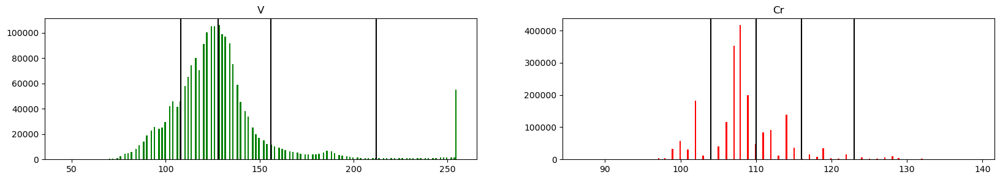

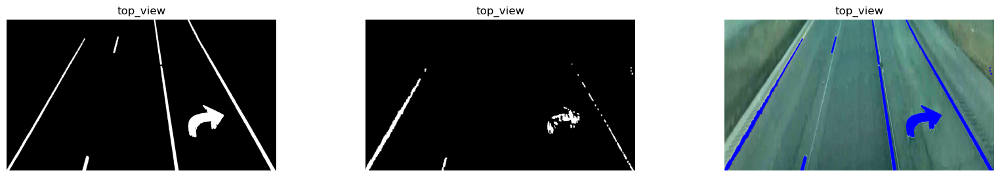

46


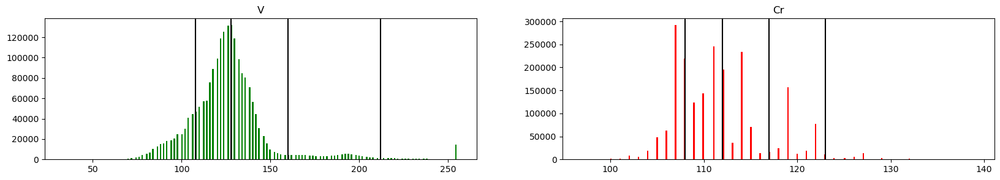

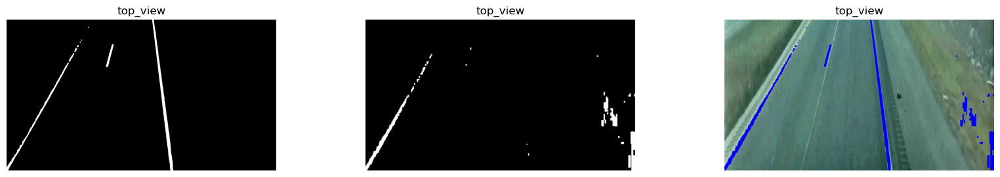

51


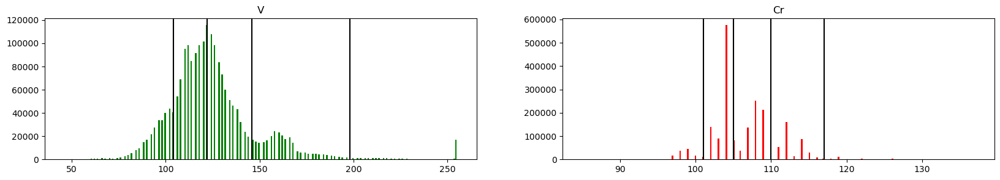

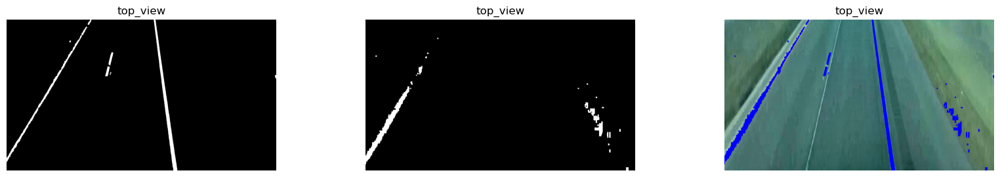

56


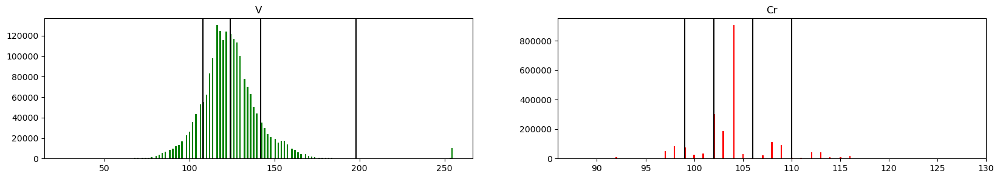

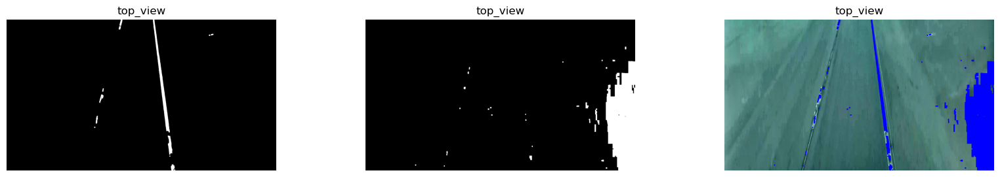

61


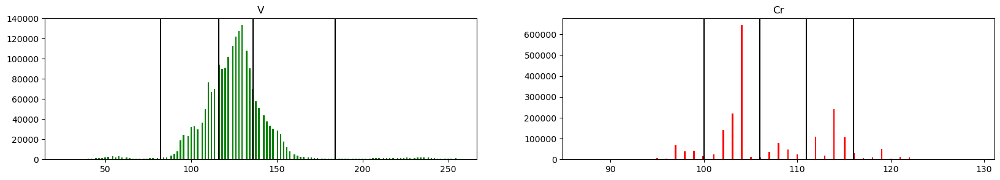

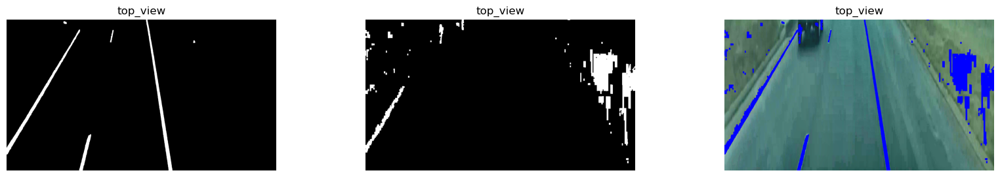

66


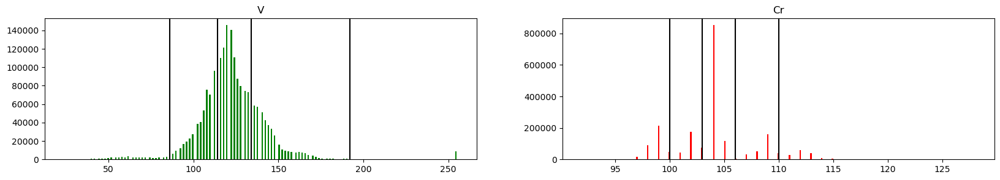

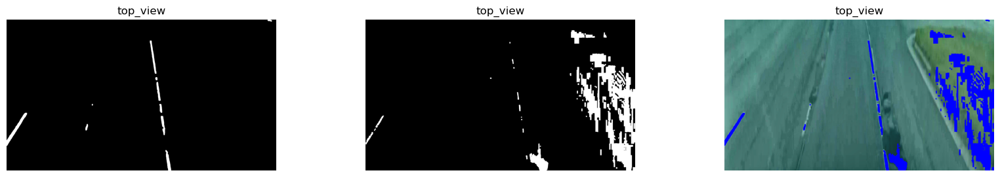

71


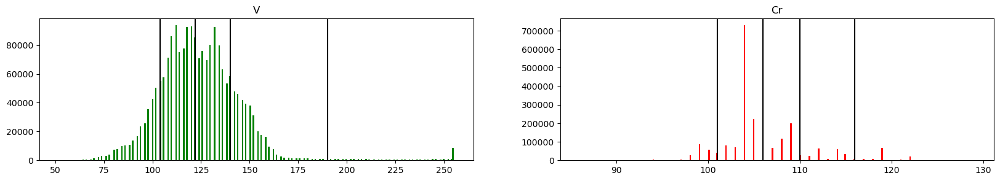

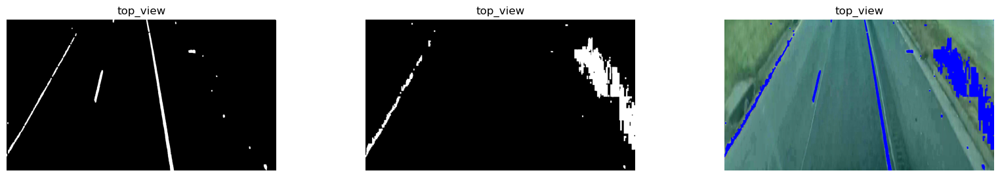

76


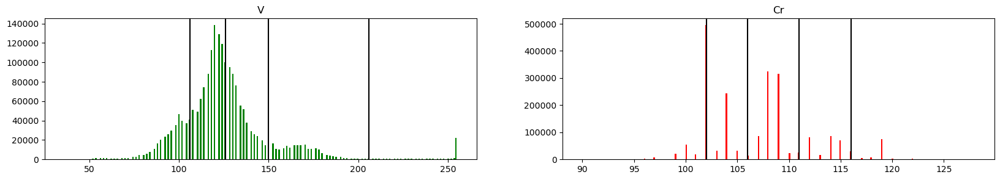

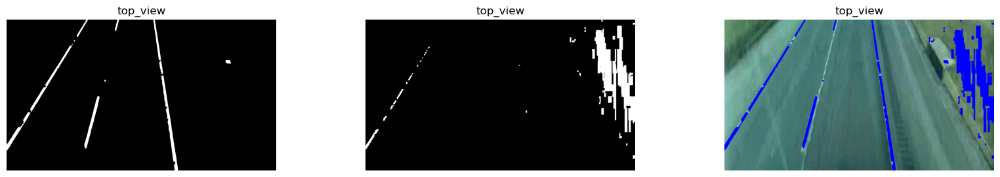

81


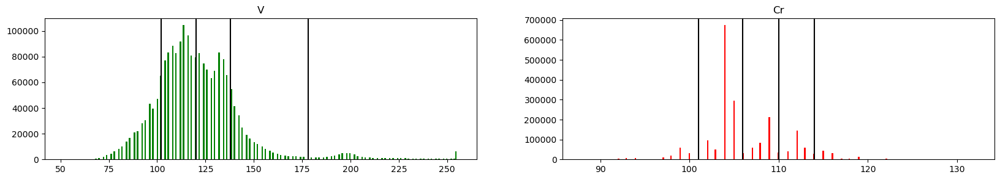

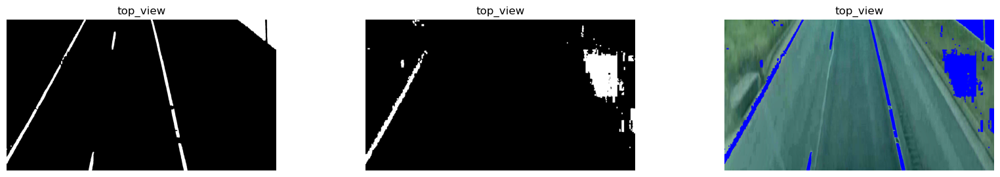

86


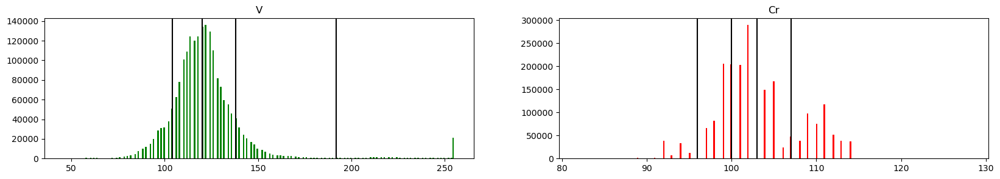

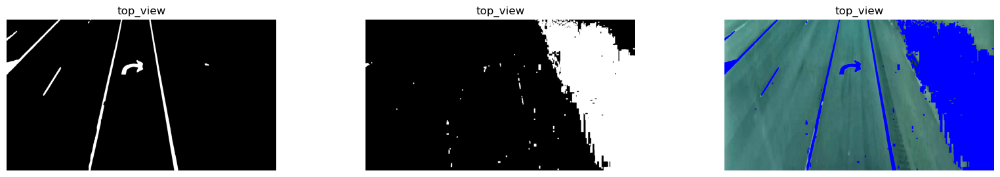

In [80]:
for i in np.arange(1,89,5):
    print(i)
    image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
        
    mask=image.copy()
    mask[:int(2*mask.shape[0]/3),:]=0
    mask[1000:,:]=0
    top_view=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)   
    top_view = cv2.convertScaleAbs(top_view, alpha=2, beta=20)
    
    top_view1=cv2.cvtColor(top_view, cv2.COLOR_BGR2HSV)
    H,S,V = cv2.split(top_view1)
    
    top_view2=cv2.cvtColor(top_view, cv2.COLOR_BGR2YCrCb)
    Y,Cr,Cb = cv2.split(top_view2)
    
    
    fig, ax = plt.subplots(1, 2, figsize=(20, 3))
    
    ax[0].hist(V.ravel(), bins=255,color='green')
    ax[0].set_title('V')
    Vthresholds = threshold_multiotsu(V, classes=5)
    for thresh in Vthresholds:
        ax[0].axvline(thresh, color='black')
    
    ax[1].hist(Cr.ravel(), bins=255,color='red')
    ax[1].set_title('Cr')
    Crthresholds = threshold_multiotsu(Cr, classes=5)
    for thresh in Crthresholds:
        ax[1].axvline(thresh, color='black')


    plt.show()     
    kernel = np.ones((3, 3), np.uint8)  
        
    fig, ax = plt.subplots(1, 3, figsize=(20, 3))
    
    _, output = cv2.threshold(V, 1*Vthresholds[-1], 255, cv2.THRESH_BINARY)
    output = cv2.erode(output, kernel, iterations=2)
    output = cv2.dilate(output, kernel, iterations=3)
    top_view[output==255]=[255,0,0]
    ax[0].imshow(output,cmap='gray')
    ax[0].set_title('top_view')
    ax[0].axis('off')
    
    _, output = cv2.threshold(Cr, 1*Crthresholds[-1], 255, cv2.THRESH_BINARY)
    output = cv2.erode(output, kernel, iterations=2)
    output = cv2.dilate(output, kernel, iterations=3)
    ax[1].imshow(output,cmap='gray')
    ax[1].set_title('top_view')
    ax[1].axis('off')
       
        
    top_view[output==255]=[255,0,0]
    
    ax[2].imshow(cv2.cvtColor(top_view, cv2.COLOR_BGR2RGB))
    ax[2].set_title('top_view')
    ax[2].axis('off')
       
    plt.show()
    
    
    


In [ ]:
# for i in np.arange(1,89,5):
#     print(i)
#     image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
        
#     mask=image.copy()
#     mask[:int(2*mask.shape[0]/3),:]=0
#     mask[1000:,:]=0
#     top_view=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)   
    
#     top_view1 = cv2.convertScaleAbs(top_view, alpha=2, beta=20)

    
#     top_view1=cv2.cvtColor(top_view1, cv2.COLOR_BGR2RGB)
#     red_channel,green_channel,blue_channel = cv2.split(top_view1)
#     H = 255 - red_channel
#     S = 255 - green_channel
#     V = 255 - blue_channel
    
#     fig, ax = plt.subplots(1, 3, figsize=(20, 3))
#     ax[0].hist(H.ravel(), bins=255,color='blue')
#     ax[0].set_title('H')
#     Hthresholds = threshold_multiotsu(H, classes=3)
#     for thresh in Hthresholds:
#         ax[0].axvline(thresh, color='black')
    
#     ax[1].hist(S.ravel(), bins=255,color='red')
#     ax[1].set_title('S')
#     Sthresholds = threshold_multiotsu(S, classes=3)
#     for thresh in Sthresholds:
#         ax[1].axvline(thresh, color='black')
    
#     ax[2].hist(V.ravel(), bins=255,color='green')
#     ax[2].set_title('V')
#     Vthresholds = threshold_multiotsu(V, classes=3)
#     for thresh in Vthresholds:
#         ax[2].axvline(thresh, color='black')

#     plt.show()     
        
        
#     fig, ax = plt.subplots(1, 3, figsize=(20, 3))
#     ax[0].imshow(H,cmap='gray')
#     ax[0].set_title('top_view')
#     ax[0].axis('off')
    
#     ax[1].imshow(S,cmap='gray')
#     ax[1].set_title('top_view')
#     ax[1].axis('off')
    
# #     _, output = cv2.threshold(V, 1.1*Vthresholds[-1], 255, cv2.THRESH_BINARY)
    
#     ax[2].imshow(V,cmap='gray')
#     ax[2].set_title('top_view')
#     ax[2].axis('off')
    
    
#     plt.show()
    

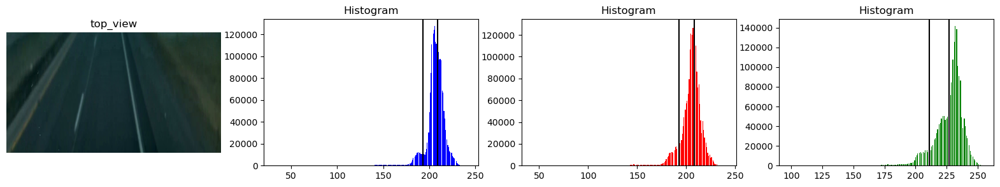

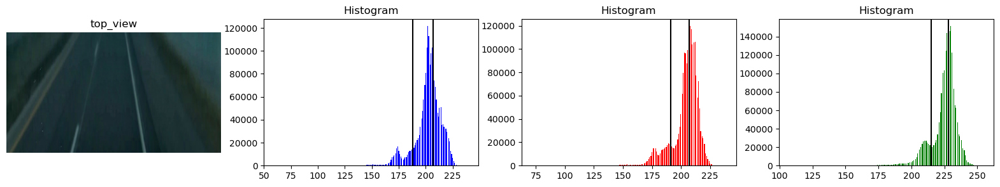

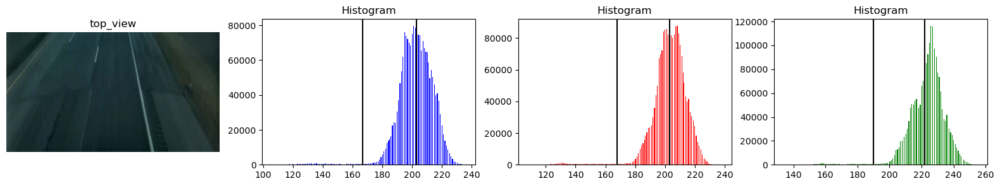

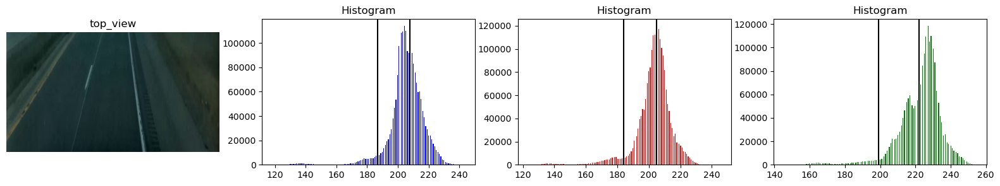

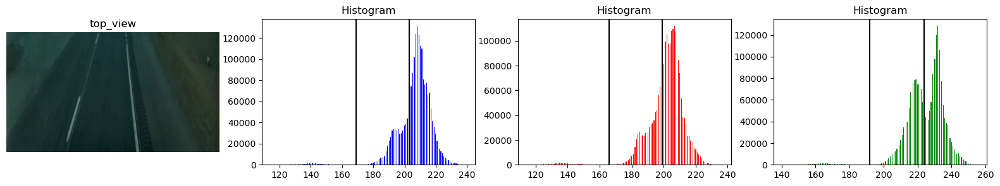

...

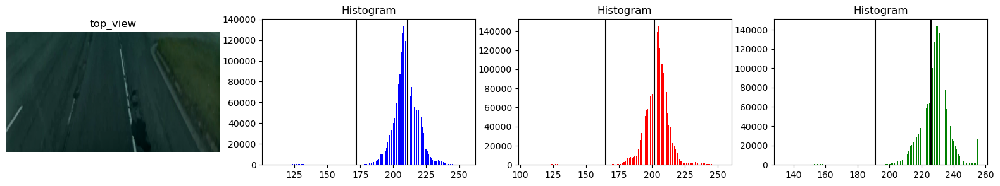

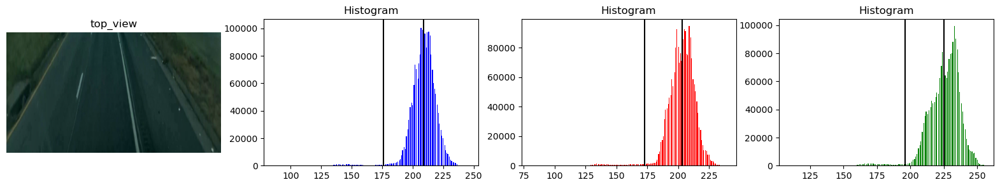

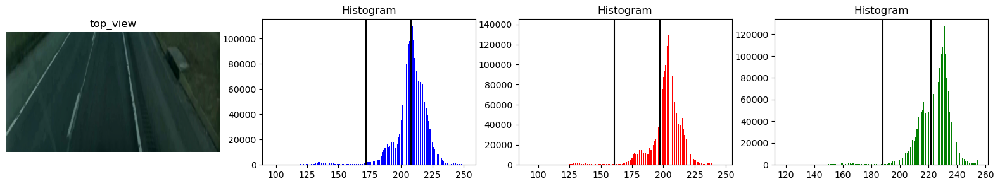

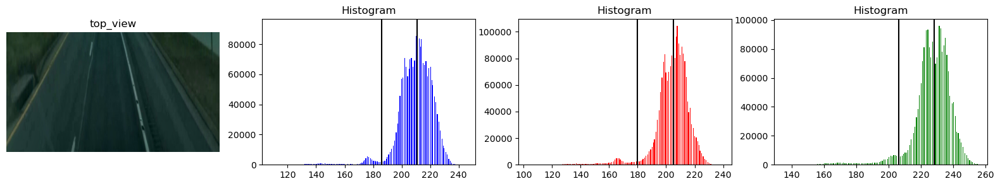

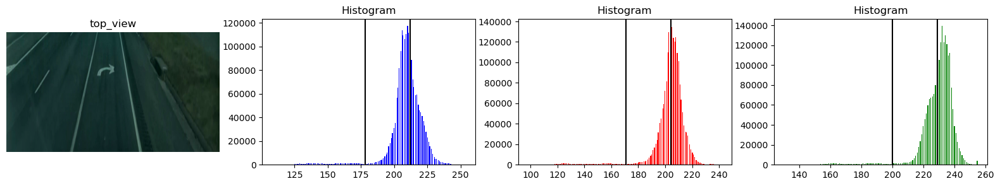

In [14]:
for i in np.arange(1,89,5):
#     print(i)
    image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
        
    mask=image.copy()
    mask[:int(2*mask.shape[0]/3),:]=0
    mask[1000:,:]=0
    top_view1=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)   
    
#     top_view1 = cv2.convertScaleAbs(top_view, alpha=2, beta=20)
    top_view1=cv2.cvtColor(top_view1, cv2.COLOR_BGR2RGB)
    red_channel,green_channel,blue_channel = cv2.split(top_view1)
    # Step 3: Calculate the CMY channels
    r = 255 - red_channel
    g = 255 - green_channel
    b = 255 - blue_channel
    
    fig, ax = plt.subplots(1, 4, figsize=(20, 3))
    ax[0].imshow(top_view1)
    ax[0].set_title('top_view')
    ax[0].axis('off')
    

    ax[1].hist(b.ravel(), bins=255,color='blue')
    ax[1].set_title('Histogram')
    thresholds = threshold_multiotsu(b, classes=3)
    for thresh in thresholds:
        ax[1].axvline(thresh, color='black')
    
    ax[2].hist(g.ravel(), bins=255,color='red')
    ax[2].set_title('Histogram')
    thresholds = threshold_multiotsu(g, classes=3)
    for thresh in thresholds:
        ax[2].axvline(thresh, color='black')
    
    ax[3].hist(r.ravel(), bins=255,color='green')
    ax[3].set_title('Histogram')
    thresholds = threshold_multiotsu(r, classes=3)
    for thresh in thresholds:
        ax[3].axvline(thresh, color='black')

    plt.show()
    

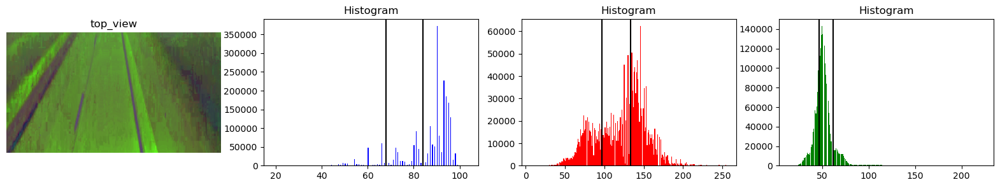

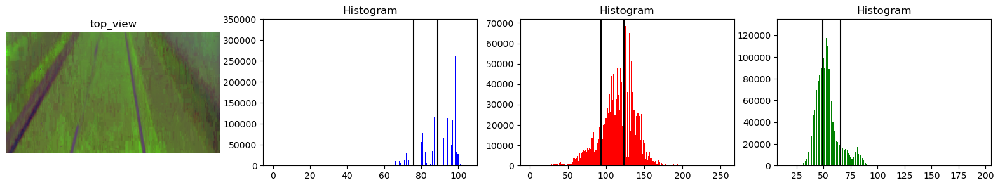

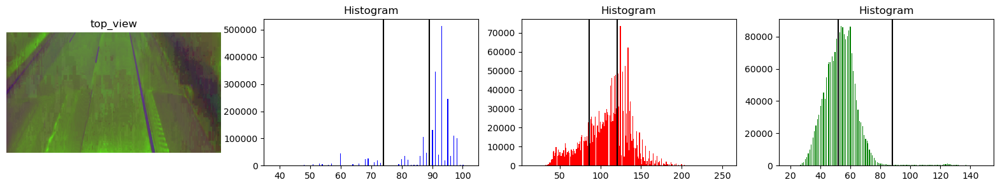

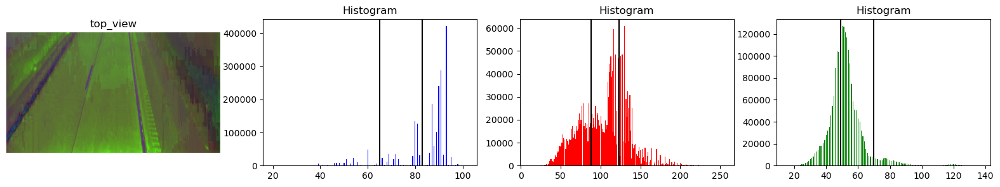

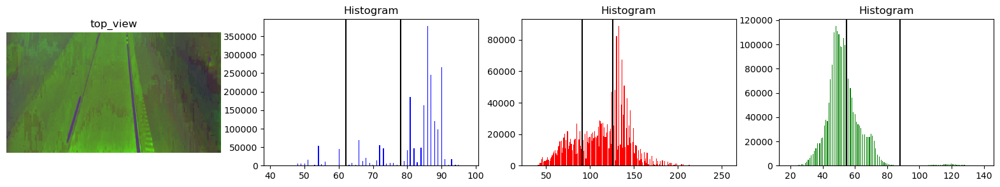

...

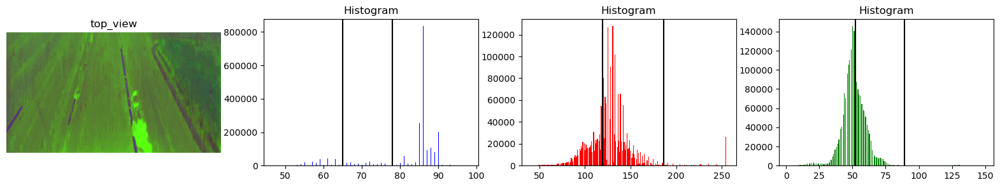

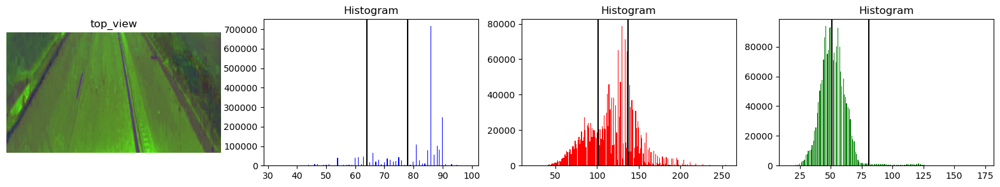

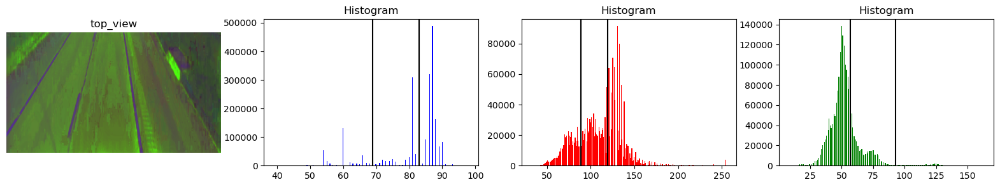

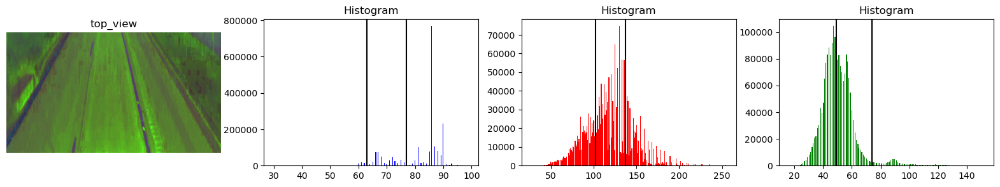

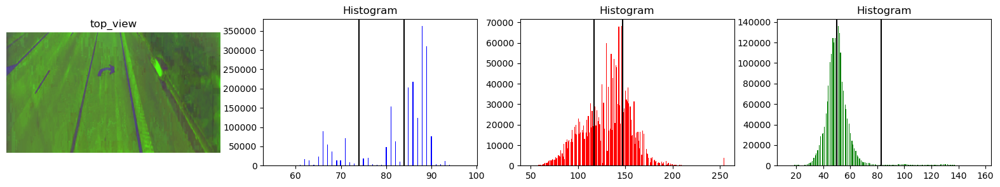

In [80]:
for i in np.arange(1,89,5):
#     print(i)
    image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
        
    mask=image.copy()
    mask[:int(2*mask.shape[0]/3),:]=0
    mask[1000:,:]=0
    top_view1=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)   
    
#     top_view1 = cv2.convertScaleAbs(top_view, alpha=2, beta=20)
    top_view1=cv2.cvtColor(top_view1, cv2.COLOR_BGR2HSV)
    b,g,r = cv2.split(top_view1)
    
    fig, ax = plt.subplots(1, 4, figsize=(20, 3))
    ax[0].imshow(top_view1)
    ax[0].set_title('top_view')
    ax[0].axis('off')
    

    ax[1].hist(b.ravel(), bins=255,color='blue')
    ax[1].set_title('Histogram')
    thresholds = threshold_multiotsu(b, classes=3)
    for thresh in thresholds:
        ax[1].axvline(thresh, color='black')
    
    ax[2].hist(g.ravel(), bins=255,color='red')
    ax[2].set_title('Histogram')
    thresholds = threshold_multiotsu(g, classes=3)
    for thresh in thresholds:
        ax[2].axvline(thresh, color='black')
    
    ax[3].hist(r.ravel(), bins=255,color='green')
    ax[3].set_title('Histogram')
    thresholds = threshold_multiotsu(r, classes=3)
    for thresh in thresholds:
        ax[3].axvline(thresh, color='black')

    plt.show()
    

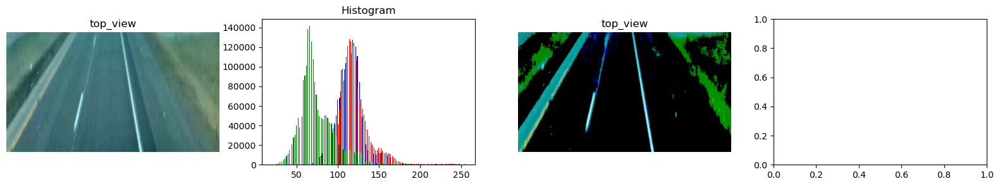

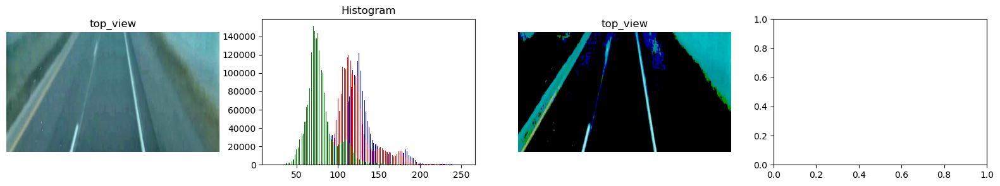

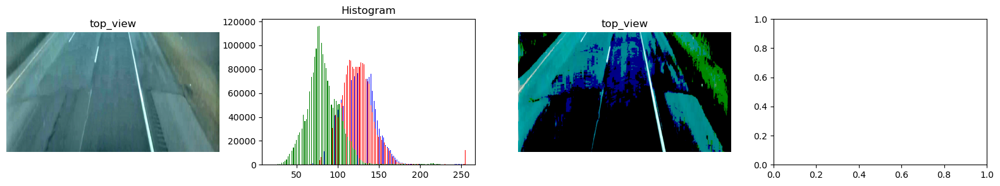

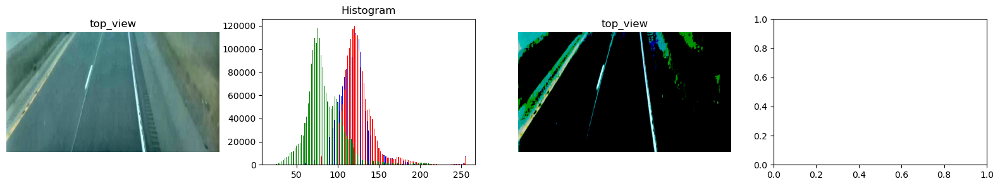

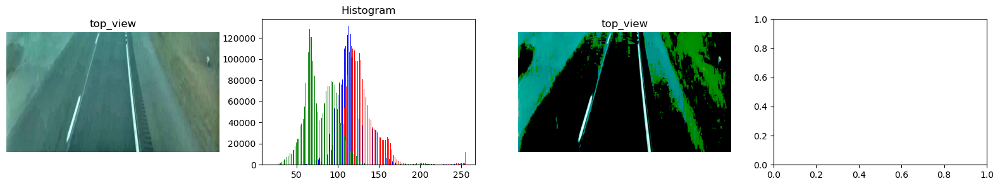

...

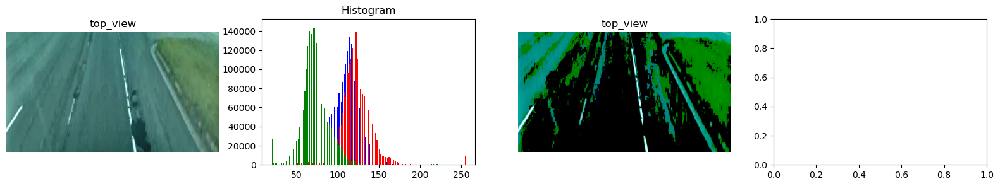

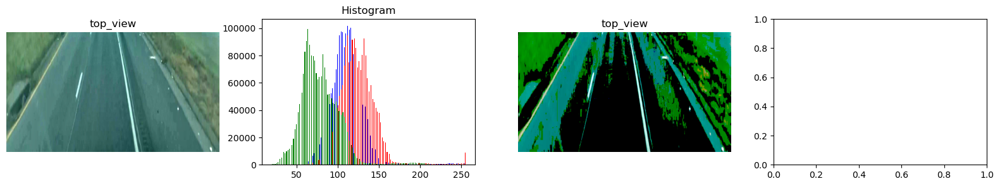

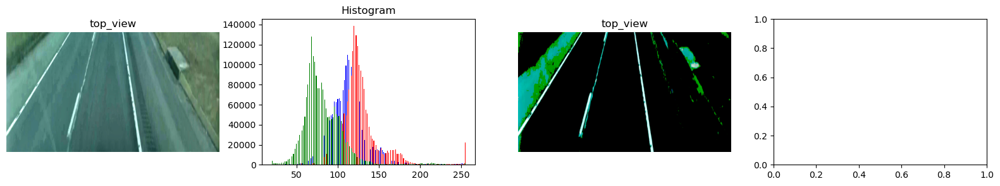

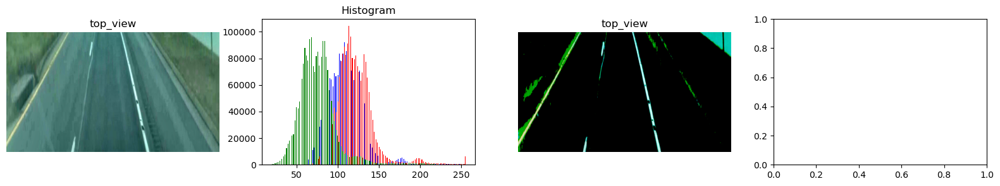

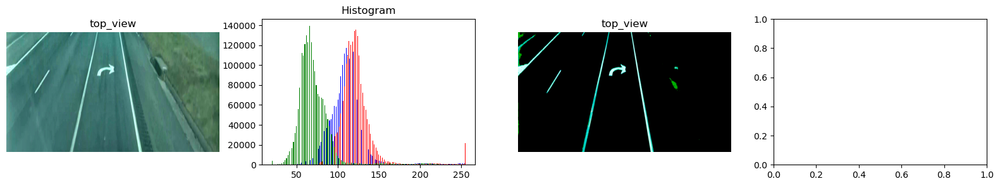

In [75]:
for i in np.arange(1,89,5):
#     print(i)
    image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
        
    mask=image.copy()
    mask[:int(2*mask.shape[0]/3),:]=0
    mask[1000:,:]=0
    top_view=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)   
    
    top_view1 = cv2.convertScaleAbs(top_view, alpha=2, beta=20)
    
    fig, ax = plt.subplots(1, 4, figsize=(20, 3))
    ax[0].imshow(cv2.cvtColor(top_view1, cv2.COLOR_BGR2RGB))
    ax[0].set_title('top_view')
    ax[0].axis('off')
    
    thresholds = threshold_multiotsu(top_view1, classes=3)
    ax[1].hist(top_view1[:,:,0].ravel(), bins=255,color='blue')
    ax[1].set_title('Histogram')
#     for thresh in thresholds:
#         ax[1].axvline(thresh, color='r')
    
    ax[1].hist(top_view1[:,:,1].ravel(), bins=255,color='red')
    ax[1].set_title('Histogram')
#     for thresh in thresholds:
#         ax[1].axvline(thresh, color='r')
    
    ax[1].hist(top_view1[:,:,2].ravel(), bins=255,color='green')
    ax[1].set_title('Histogram')
#     for thresh in thresholds:
#         ax[1].axvline(thresh, color='r')

    top_view1[top_view1<thresholds[1]]=0
    ax[2].imshow(cv2.cvtColor(top_view1, cv2.COLOR_BGR2RGB))
    ax[2].set_title('top_view')
    ax[2].axis('off')
    
    
#     thresholds = threshold_multiotsu(top_view2, classes=2)
    
#     ax[3].hist(modified_hsv_image.ravel(), bins=255)
#     ax[3].set_title('Histogram')
   
#     for thresh in thresholds:
#         ax[3].axvline(thresh, color='r')
    
    plt.show()
    
    


In [ ]:
for i in np.arange(1,89,5):
    print(i)
    image = cv2.imread(f'1_fog_frames_out/frame_{i}.png')
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = image.astype(np.float64) / 255.0
    
    mask=image.copy()
    mask[:int(2*mask.shape[0]/3),:]=0
    mask[1000:,:]=0
    top_view=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR)   
    top_view = cv2.convertScaleAbs(top_view, alpha=100, beta=100)
#     kernel = np.array([[0, -1, 0],
#                [-1, 5,-1],
#                [0, -1, 0]])
#     img = cv2.filter2D(src=top_view, ddepth=-1, kernel=kernel)

    sigma_est = np.mean(estimate_sigma(top_view, multichannel=True))
    denoise_img = denoise_nl_means(top_view, h=1.15 * sigma_est, fast_mode=True, 
                       patch_size=5, patch_distance=3, multichannel=True)


    image = (exposure.equalize_adapthist(denoise_img))

    thresholds = threshold_multiotsu(image, classes=n_class)


    
    regions = np.digitize(image, bins=thresholds)
    
    regions = random_walker(image, regions+1, beta=10, mode='bf')
    output =(255*(regions/(n_class))).astype(np.uint8)  #Convert 64 bit integer values to uint8



    fig, ax = plt.subplots(nrows=1, ncols=2,figsize=(20, 3))
    ax[0].hist(image.ravel(), bins=255)
    ax[0].set_title('Histogram')
    for thresh in thresholds:
        ax[0].axvline(thresh, color='r')

    # output[output<125]=0
    # output[output>=125]=255
    gray = cv2.cvtColor(output, cv2.COLOR_BGR2GRAY)

#     # Apply thresholding
    _, output = cv2.threshold(gray, 170, 255, cv2.THRESH_BINARY)
    kernel = np.ones((3, 3), np.uint8)
    
    output = cv2.erode(output, kernel, iterations=2)
#     output = cv2.dilate(output, kernel, iterations=1)
    # Plotting the Multi Otsu result.
    ax[1].imshow(output, cmap='gray')
    ax[1].set_title('Multi-Otsu result')
    ax[1].axis('off')

#     lanes = cv2.HoughLinesP(output, 1, np.pi/180, 100, np.array([]), minLineLength=100, maxLineGap=2)
# #     lanes = average_slope_intercept(top_view.copy(),lanes)
#     lanes=display_advlines(top_view.copy(),lanes)
#     image = io.imread(f'1_fog_frames_out/frame_{i}.png')
#     mask=image.copy()
#     mask[:int(2*mask.shape[0]/3),:]=0
#     mask[1000:,:]=0
#     top_view=tr_top_view(mask, img_size=(mask.shape[1],mask.shape[0]), flags=cv2.INTER_LINEAR) 
#     ax[2].imshow(cv2.cvtColor(cv2.addWeighted(lanes, 1, top_view, 0.6, 0), cv2.COLOR_BGR2RGB))
#     ax[2].set_title('finall hough')
#     plt.subplots_adjust()

    plt.show()